# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

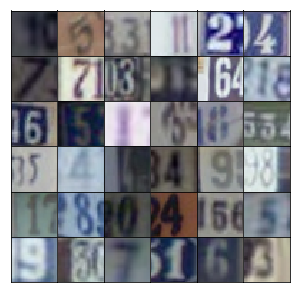

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [18]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x = tf.layers.dense(z, 4*4*512)
        x = tf.reshape(x,(-1,4,4,512))
        x = tf.layers.batch_normalization(x, training=training)
        x = tf.maximum(alpha * x, x)
        
        #conv1
        conv1 = tf.layers.conv2d_transpose(x, 256, 5, strides=2, padding='same')
        conv1 = tf.layers.batch_normalization(conv1, training=training)
        conv1 = tf.maximum(alpha * conv1, conv1)
        
        #conv2
        conv2 = tf.layers.conv2d_transpose(conv1, 128, 5, strides=2, padding='same')
        conv2 = tf.layers.batch_normalization(conv2, training=training)
        conv2 = tf.maximum(alpha * conv2, conv2)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(conv2, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [19]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x,64,5,strides=2,padding='same')
        x1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d(x1,128,5,strides=2,padding='same')
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha * x2, x2)

        x3 = tf.layers.conv2d(x2,256,5,strides=2,padding='same')
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha * x3, x3)
        
        flat = tf.reshape(x3,(-1,4*4*256))
        logits = tf.layers.dense(flat,1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [20]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [21]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [22]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [23]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [24]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [25]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size =128
epochs = 30
alpha = 0.01
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/30... Discriminator Loss: 1.2557... Generator Loss: 0.7333
Epoch 1/30... Discriminator Loss: 0.4019... Generator Loss: 1.6948
Epoch 1/30... Discriminator Loss: 0.1410... Generator Loss: 3.3908
Epoch 1/30... Discriminator Loss: 0.1573... Generator Loss: 2.5546
Epoch 1/30... Discriminator Loss: 0.1850... Generator Loss: 2.5855
Epoch 1/30... Discriminator Loss: 0.0718... Generator Loss: 3.3889
Epoch 1/30... Discriminator Loss: 0.0959... Generator Loss: 2.8521
Epoch 1/30... Discriminator Loss: 0.1151... Generator Loss: 3.2848
Epoch 1/30... Discriminator Loss: 0.1339... Generator Loss: 2.9897
Epoch 1/30... Discriminator Loss: 0.1041... Generator Loss: 3.7269


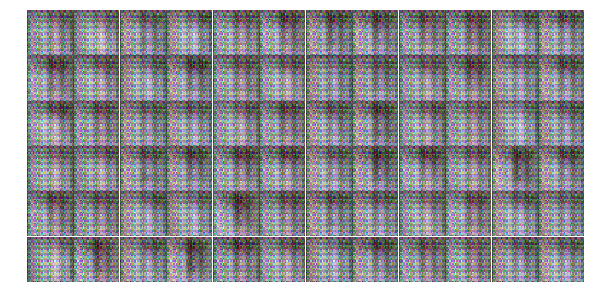

Epoch 1/30... Discriminator Loss: 0.9017... Generator Loss: 2.0394
Epoch 1/30... Discriminator Loss: 0.5952... Generator Loss: 1.7705
Epoch 1/30... Discriminator Loss: 0.4734... Generator Loss: 1.8593
Epoch 1/30... Discriminator Loss: 0.4729... Generator Loss: 1.4362
Epoch 1/30... Discriminator Loss: 0.5380... Generator Loss: 2.2420
Epoch 1/30... Discriminator Loss: 0.5741... Generator Loss: 2.0995
Epoch 1/30... Discriminator Loss: 0.2654... Generator Loss: 2.4525
Epoch 1/30... Discriminator Loss: 0.1919... Generator Loss: 3.1813
Epoch 1/30... Discriminator Loss: 0.2449... Generator Loss: 2.2661
Epoch 1/30... Discriminator Loss: 0.3547... Generator Loss: 1.9029


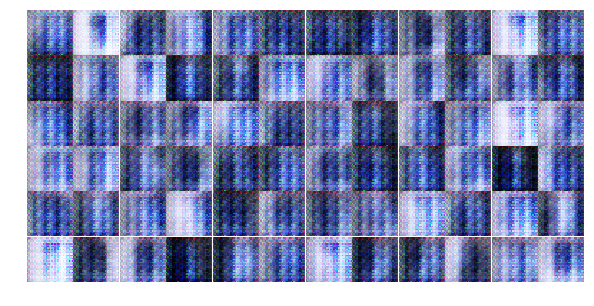

Epoch 1/30... Discriminator Loss: 2.2257... Generator Loss: 0.1596
Epoch 1/30... Discriminator Loss: 0.5788... Generator Loss: 2.9851
Epoch 1/30... Discriminator Loss: 0.3589... Generator Loss: 3.0427
Epoch 1/30... Discriminator Loss: 0.6778... Generator Loss: 1.9055
Epoch 1/30... Discriminator Loss: 2.0517... Generator Loss: 4.0760
Epoch 1/30... Discriminator Loss: 1.1231... Generator Loss: 2.4402
Epoch 1/30... Discriminator Loss: 2.8154... Generator Loss: 0.1738
Epoch 1/30... Discriminator Loss: 1.3124... Generator Loss: 0.9352
Epoch 1/30... Discriminator Loss: 0.7340... Generator Loss: 1.4254
Epoch 1/30... Discriminator Loss: 0.5971... Generator Loss: 1.3954


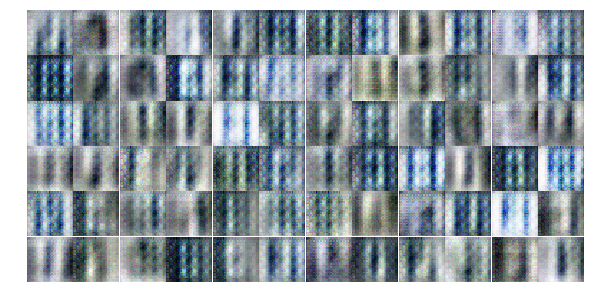

Epoch 1/30... Discriminator Loss: 0.9203... Generator Loss: 1.2538
Epoch 1/30... Discriminator Loss: 0.3665... Generator Loss: 1.8740
Epoch 1/30... Discriminator Loss: 0.3707... Generator Loss: 1.9425
Epoch 1/30... Discriminator Loss: 0.8211... Generator Loss: 1.1188
Epoch 1/30... Discriminator Loss: 0.8093... Generator Loss: 1.1796
Epoch 1/30... Discriminator Loss: 0.5109... Generator Loss: 1.7334
Epoch 1/30... Discriminator Loss: 0.8126... Generator Loss: 1.0036
Epoch 1/30... Discriminator Loss: 0.6009... Generator Loss: 2.0137
Epoch 1/30... Discriminator Loss: 0.6474... Generator Loss: 2.0819
Epoch 1/30... Discriminator Loss: 0.5808... Generator Loss: 1.7387


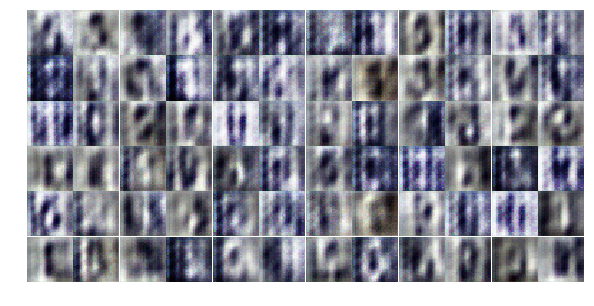

Epoch 1/30... Discriminator Loss: 0.5819... Generator Loss: 2.2704
Epoch 1/30... Discriminator Loss: 0.3460... Generator Loss: 2.3583
Epoch 1/30... Discriminator Loss: 0.4146... Generator Loss: 2.8236
Epoch 1/30... Discriminator Loss: 1.4270... Generator Loss: 2.5589
Epoch 1/30... Discriminator Loss: 0.6118... Generator Loss: 1.7056
Epoch 1/30... Discriminator Loss: 0.3950... Generator Loss: 1.7892
Epoch 1/30... Discriminator Loss: 0.4424... Generator Loss: 2.2122
Epoch 1/30... Discriminator Loss: 0.4659... Generator Loss: 1.8892
Epoch 1/30... Discriminator Loss: 0.5431... Generator Loss: 1.3545
Epoch 1/30... Discriminator Loss: 1.0354... Generator Loss: 0.7297


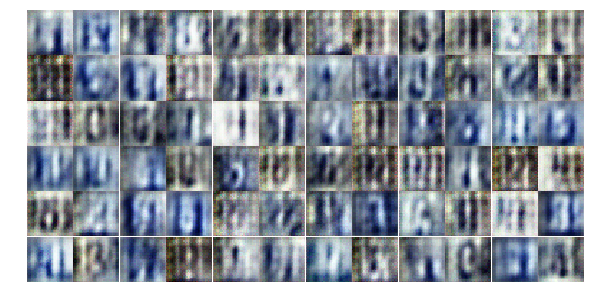

Epoch 1/30... Discriminator Loss: 0.6484... Generator Loss: 1.2342
Epoch 1/30... Discriminator Loss: 1.6481... Generator Loss: 0.2994
Epoch 1/30... Discriminator Loss: 0.7769... Generator Loss: 1.6302
Epoch 1/30... Discriminator Loss: 1.2320... Generator Loss: 1.1508
Epoch 1/30... Discriminator Loss: 1.1637... Generator Loss: 1.2258
Epoch 1/30... Discriminator Loss: 1.4973... Generator Loss: 0.4613
Epoch 1/30... Discriminator Loss: 1.0401... Generator Loss: 1.1357
Epoch 2/30... Discriminator Loss: 0.9438... Generator Loss: 1.7677
Epoch 2/30... Discriminator Loss: 1.1049... Generator Loss: 1.0867
Epoch 2/30... Discriminator Loss: 1.2809... Generator Loss: 0.6004


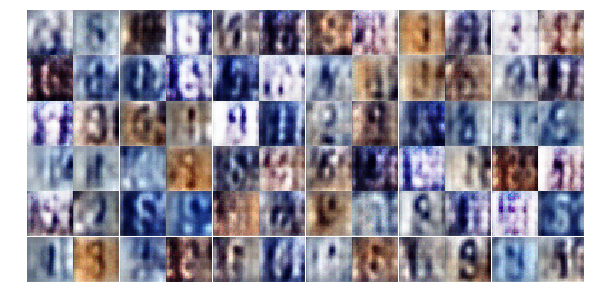

Epoch 2/30... Discriminator Loss: 1.1671... Generator Loss: 0.9575
Epoch 2/30... Discriminator Loss: 1.1582... Generator Loss: 0.8415
Epoch 2/30... Discriminator Loss: 1.0547... Generator Loss: 1.2366
Epoch 2/30... Discriminator Loss: 1.1479... Generator Loss: 1.0509
Epoch 2/30... Discriminator Loss: 1.1401... Generator Loss: 0.9745
Epoch 2/30... Discriminator Loss: 1.2661... Generator Loss: 1.1865
Epoch 2/30... Discriminator Loss: 0.9887... Generator Loss: 0.9867
Epoch 2/30... Discriminator Loss: 1.0334... Generator Loss: 1.3525
Epoch 2/30... Discriminator Loss: 1.1860... Generator Loss: 0.7106
Epoch 2/30... Discriminator Loss: 0.8514... Generator Loss: 1.0713


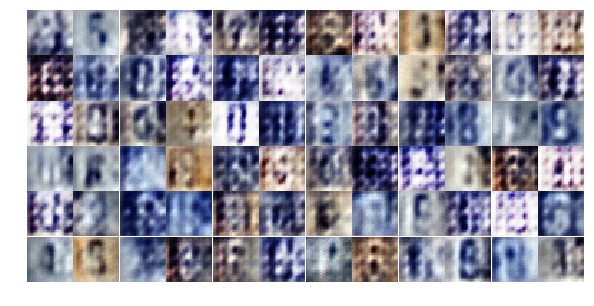

Epoch 2/30... Discriminator Loss: 1.2551... Generator Loss: 0.6895
Epoch 2/30... Discriminator Loss: 1.0232... Generator Loss: 1.4861
Epoch 2/30... Discriminator Loss: 0.8875... Generator Loss: 1.0674
Epoch 2/30... Discriminator Loss: 1.0567... Generator Loss: 0.8649
Epoch 2/30... Discriminator Loss: 1.2402... Generator Loss: 1.2097
Epoch 2/30... Discriminator Loss: 1.2891... Generator Loss: 0.7362
Epoch 2/30... Discriminator Loss: 1.0128... Generator Loss: 1.0592
Epoch 2/30... Discriminator Loss: 1.1652... Generator Loss: 0.7894
Epoch 2/30... Discriminator Loss: 1.0819... Generator Loss: 0.9275
Epoch 2/30... Discriminator Loss: 1.1800... Generator Loss: 0.8617


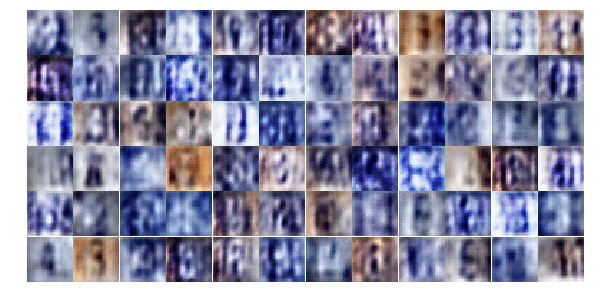

Epoch 2/30... Discriminator Loss: 1.1723... Generator Loss: 0.8217
Epoch 2/30... Discriminator Loss: 1.0663... Generator Loss: 1.0327
Epoch 2/30... Discriminator Loss: 1.2869... Generator Loss: 0.8128
Epoch 2/30... Discriminator Loss: 1.0854... Generator Loss: 0.8906
Epoch 2/30... Discriminator Loss: 0.9874... Generator Loss: 1.4237
Epoch 2/30... Discriminator Loss: 0.8826... Generator Loss: 1.0371
Epoch 2/30... Discriminator Loss: 0.9330... Generator Loss: 1.0734
Epoch 2/30... Discriminator Loss: 0.9425... Generator Loss: 0.9176
Epoch 2/30... Discriminator Loss: 0.9954... Generator Loss: 1.1051
Epoch 2/30... Discriminator Loss: 1.0244... Generator Loss: 0.8340


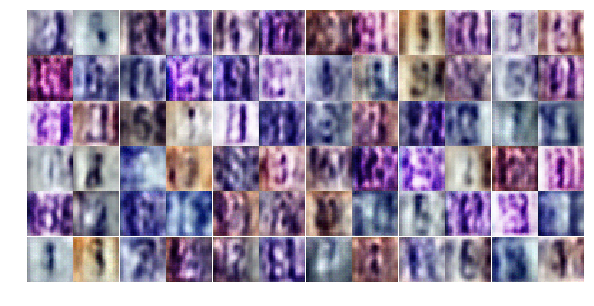

Epoch 2/30... Discriminator Loss: 1.4366... Generator Loss: 0.7031
Epoch 2/30... Discriminator Loss: 1.4077... Generator Loss: 0.7150
Epoch 2/30... Discriminator Loss: 1.1737... Generator Loss: 0.7070
Epoch 2/30... Discriminator Loss: 1.1060... Generator Loss: 0.7160
Epoch 2/30... Discriminator Loss: 0.8502... Generator Loss: 1.2847
Epoch 2/30... Discriminator Loss: 1.0524... Generator Loss: 0.8940
Epoch 2/30... Discriminator Loss: 0.8981... Generator Loss: 1.1262
Epoch 2/30... Discriminator Loss: 0.8517... Generator Loss: 1.2325
Epoch 2/30... Discriminator Loss: 1.1159... Generator Loss: 0.8546
Epoch 2/30... Discriminator Loss: 0.9489... Generator Loss: 1.2482


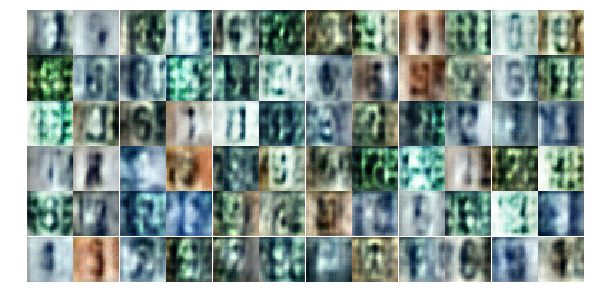

Epoch 2/30... Discriminator Loss: 0.8074... Generator Loss: 1.3742
Epoch 2/30... Discriminator Loss: 1.1043... Generator Loss: 0.7623
Epoch 2/30... Discriminator Loss: 0.8587... Generator Loss: 1.0484
Epoch 2/30... Discriminator Loss: 0.9488... Generator Loss: 0.9898
Epoch 2/30... Discriminator Loss: 1.0077... Generator Loss: 1.2817
Epoch 2/30... Discriminator Loss: 1.0337... Generator Loss: 0.7787
Epoch 2/30... Discriminator Loss: 0.6351... Generator Loss: 1.6662
Epoch 2/30... Discriminator Loss: 0.8176... Generator Loss: 1.3044
Epoch 2/30... Discriminator Loss: 0.9112... Generator Loss: 0.7340
Epoch 2/30... Discriminator Loss: 0.8820... Generator Loss: 1.5125


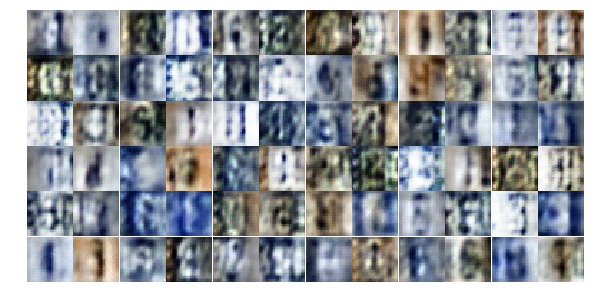

Epoch 2/30... Discriminator Loss: 0.7214... Generator Loss: 1.4236
Epoch 2/30... Discriminator Loss: 0.9130... Generator Loss: 1.2849
Epoch 2/30... Discriminator Loss: 0.8533... Generator Loss: 1.2832
Epoch 2/30... Discriminator Loss: 1.0662... Generator Loss: 0.9772
Epoch 3/30... Discriminator Loss: 0.7020... Generator Loss: 1.7855
Epoch 3/30... Discriminator Loss: 0.7891... Generator Loss: 1.1201
Epoch 3/30... Discriminator Loss: 0.7554... Generator Loss: 1.5071
Epoch 3/30... Discriminator Loss: 0.7649... Generator Loss: 1.2295
Epoch 3/30... Discriminator Loss: 0.9865... Generator Loss: 0.7661
Epoch 3/30... Discriminator Loss: 0.9088... Generator Loss: 1.8131


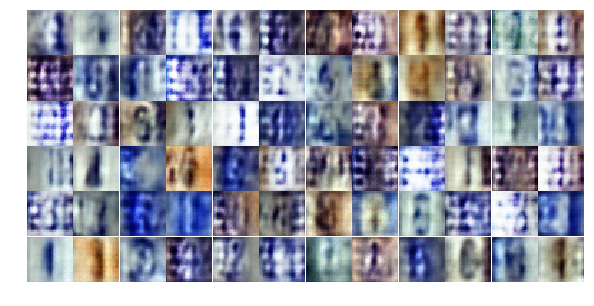

Epoch 3/30... Discriminator Loss: 0.5878... Generator Loss: 1.2777
Epoch 3/30... Discriminator Loss: 0.9706... Generator Loss: 1.3629
Epoch 3/30... Discriminator Loss: 0.9178... Generator Loss: 0.8866
Epoch 3/30... Discriminator Loss: 0.9358... Generator Loss: 0.9317
Epoch 3/30... Discriminator Loss: 0.7996... Generator Loss: 1.0634
Epoch 3/30... Discriminator Loss: 0.6077... Generator Loss: 1.4379
Epoch 3/30... Discriminator Loss: 0.6328... Generator Loss: 1.2957
Epoch 3/30... Discriminator Loss: 0.6710... Generator Loss: 1.6385
Epoch 3/30... Discriminator Loss: 2.8511... Generator Loss: 4.1710
Epoch 3/30... Discriminator Loss: 1.6039... Generator Loss: 0.3481


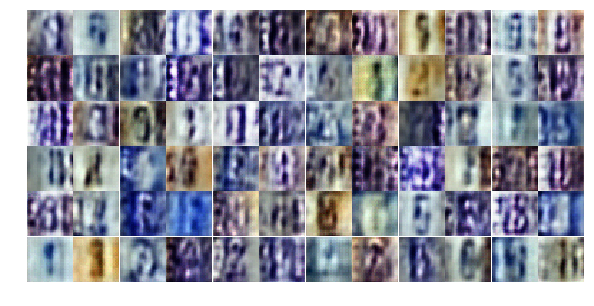

Epoch 3/30... Discriminator Loss: 0.6384... Generator Loss: 1.1825
Epoch 3/30... Discriminator Loss: 0.6871... Generator Loss: 1.2612
Epoch 3/30... Discriminator Loss: 0.6815... Generator Loss: 1.2923
Epoch 3/30... Discriminator Loss: 0.6770... Generator Loss: 1.1110
Epoch 3/30... Discriminator Loss: 0.7368... Generator Loss: 1.0449
Epoch 3/30... Discriminator Loss: 0.5278... Generator Loss: 1.5251
Epoch 3/30... Discriminator Loss: 0.8250... Generator Loss: 0.8649
Epoch 3/30... Discriminator Loss: 0.5988... Generator Loss: 1.9517
Epoch 3/30... Discriminator Loss: 0.6856... Generator Loss: 2.0317
Epoch 3/30... Discriminator Loss: 0.9302... Generator Loss: 0.7331


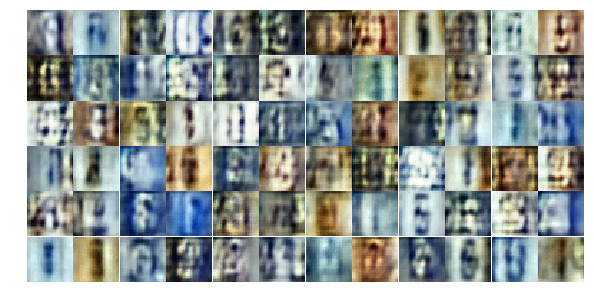

Epoch 3/30... Discriminator Loss: 0.6262... Generator Loss: 1.3293
Epoch 3/30... Discriminator Loss: 0.5598... Generator Loss: 1.4857
Epoch 3/30... Discriminator Loss: 0.5814... Generator Loss: 1.5442
Epoch 3/30... Discriminator Loss: 0.2833... Generator Loss: 1.9362
Epoch 3/30... Discriminator Loss: 1.0045... Generator Loss: 2.1862
Epoch 3/30... Discriminator Loss: 0.5610... Generator Loss: 1.6946
Epoch 3/30... Discriminator Loss: 0.8162... Generator Loss: 1.0851
Epoch 3/30... Discriminator Loss: 1.1122... Generator Loss: 0.5933
Epoch 3/30... Discriminator Loss: 0.6286... Generator Loss: 1.3808
Epoch 3/30... Discriminator Loss: 0.4518... Generator Loss: 2.0416


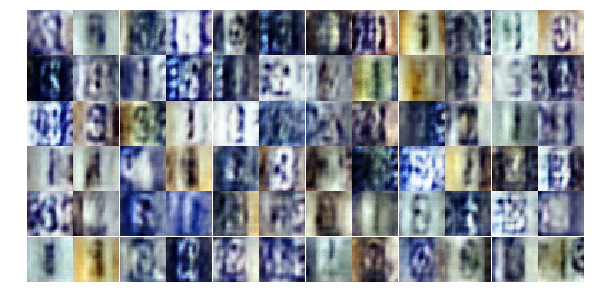

Epoch 3/30... Discriminator Loss: 0.4675... Generator Loss: 2.3748
Epoch 3/30... Discriminator Loss: 0.7302... Generator Loss: 2.4648
Epoch 3/30... Discriminator Loss: 0.4681... Generator Loss: 2.1305
Epoch 3/30... Discriminator Loss: 0.5749... Generator Loss: 1.1457
Epoch 3/30... Discriminator Loss: 0.8921... Generator Loss: 0.8408
Epoch 3/30... Discriminator Loss: 0.6006... Generator Loss: 2.1287
Epoch 3/30... Discriminator Loss: 0.4243... Generator Loss: 2.1550
Epoch 3/30... Discriminator Loss: 0.3544... Generator Loss: 1.8234
Epoch 3/30... Discriminator Loss: 2.7847... Generator Loss: 4.4910
Epoch 3/30... Discriminator Loss: 0.9311... Generator Loss: 1.8282


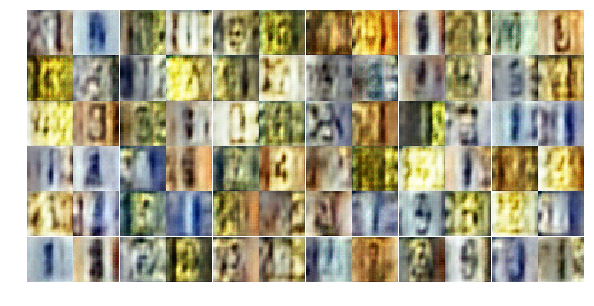

Epoch 3/30... Discriminator Loss: 1.1798... Generator Loss: 0.6943
Epoch 3/30... Discriminator Loss: 0.9112... Generator Loss: 0.9328
Epoch 3/30... Discriminator Loss: 0.7853... Generator Loss: 1.2567
Epoch 3/30... Discriminator Loss: 0.6519... Generator Loss: 1.1227
Epoch 3/30... Discriminator Loss: 0.8421... Generator Loss: 1.8414
Epoch 3/30... Discriminator Loss: 0.6386... Generator Loss: 1.9965
Epoch 3/30... Discriminator Loss: 0.5025... Generator Loss: 1.7072
Epoch 3/30... Discriminator Loss: 0.7083... Generator Loss: 1.1227
Epoch 3/30... Discriminator Loss: 0.7758... Generator Loss: 0.9572
Epoch 3/30... Discriminator Loss: 0.6176... Generator Loss: 2.1064


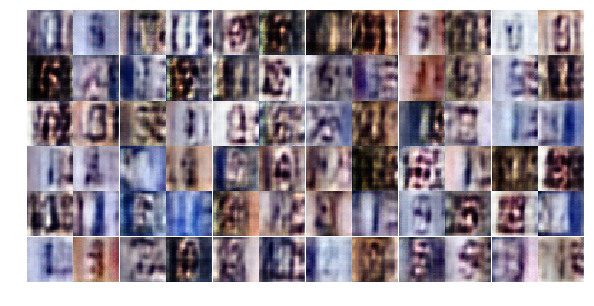

Epoch 3/30... Discriminator Loss: 0.7120... Generator Loss: 1.5174
Epoch 4/30... Discriminator Loss: 0.9927... Generator Loss: 0.7308
Epoch 4/30... Discriminator Loss: 0.6641... Generator Loss: 1.5323
Epoch 4/30... Discriminator Loss: 0.7691... Generator Loss: 1.0112
Epoch 4/30... Discriminator Loss: 0.4203... Generator Loss: 2.0718
Epoch 4/30... Discriminator Loss: 0.6073... Generator Loss: 1.1340
Epoch 4/30... Discriminator Loss: 0.7728... Generator Loss: 2.1255
Epoch 4/30... Discriminator Loss: 0.5975... Generator Loss: 1.4066
Epoch 4/30... Discriminator Loss: 0.5199... Generator Loss: 1.3377
Epoch 4/30... Discriminator Loss: 0.4766... Generator Loss: 1.6163


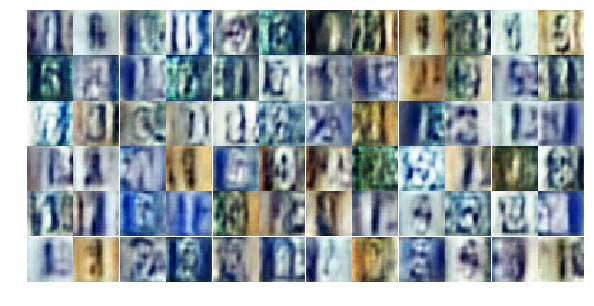

Epoch 4/30... Discriminator Loss: 0.3343... Generator Loss: 1.9958
Epoch 4/30... Discriminator Loss: 1.0403... Generator Loss: 1.4178
Epoch 4/30... Discriminator Loss: 0.9069... Generator Loss: 2.8819
Epoch 4/30... Discriminator Loss: 0.5719... Generator Loss: 1.4420
Epoch 4/30... Discriminator Loss: 0.6993... Generator Loss: 1.0423
Epoch 4/30... Discriminator Loss: 0.7594... Generator Loss: 1.3240
Epoch 4/30... Discriminator Loss: 0.5803... Generator Loss: 1.4242
Epoch 4/30... Discriminator Loss: 0.6570... Generator Loss: 1.1073
Epoch 4/30... Discriminator Loss: 0.4850... Generator Loss: 1.7861
Epoch 4/30... Discriminator Loss: 0.4653... Generator Loss: 1.8396


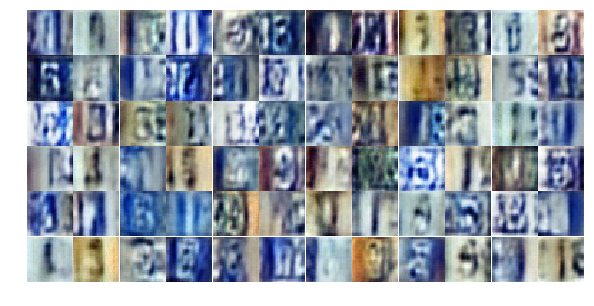

Epoch 4/30... Discriminator Loss: 0.3913... Generator Loss: 2.0377
Epoch 4/30... Discriminator Loss: 0.3220... Generator Loss: 2.0166
Epoch 4/30... Discriminator Loss: 0.8922... Generator Loss: 0.6911
Epoch 4/30... Discriminator Loss: 0.6702... Generator Loss: 1.0570
Epoch 4/30... Discriminator Loss: 0.4924... Generator Loss: 1.3869
Epoch 4/30... Discriminator Loss: 0.6505... Generator Loss: 1.9304
Epoch 4/30... Discriminator Loss: 0.3177... Generator Loss: 2.0124
Epoch 4/30... Discriminator Loss: 0.7164... Generator Loss: 2.5601
Epoch 4/30... Discriminator Loss: 0.3369... Generator Loss: 2.1307
Epoch 4/30... Discriminator Loss: 0.3207... Generator Loss: 1.8341


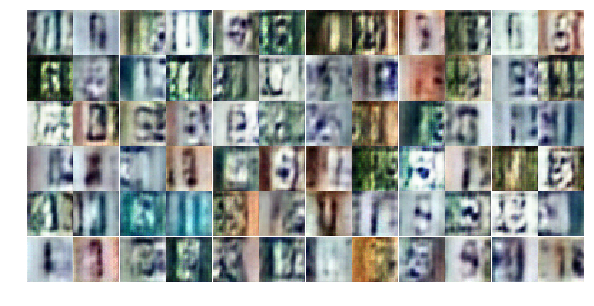

Epoch 4/30... Discriminator Loss: 0.5975... Generator Loss: 1.7142
Epoch 4/30... Discriminator Loss: 0.6574... Generator Loss: 1.3360
Epoch 4/30... Discriminator Loss: 0.6096... Generator Loss: 2.3778
Epoch 4/30... Discriminator Loss: 0.5779... Generator Loss: 2.0568
Epoch 4/30... Discriminator Loss: 0.4416... Generator Loss: 2.2310
Epoch 4/30... Discriminator Loss: 0.5175... Generator Loss: 1.7544
Epoch 4/30... Discriminator Loss: 0.9669... Generator Loss: 2.1224
Epoch 4/30... Discriminator Loss: 1.3402... Generator Loss: 2.9572
Epoch 4/30... Discriminator Loss: 0.4471... Generator Loss: 1.4497
Epoch 4/30... Discriminator Loss: 0.5732... Generator Loss: 1.2630


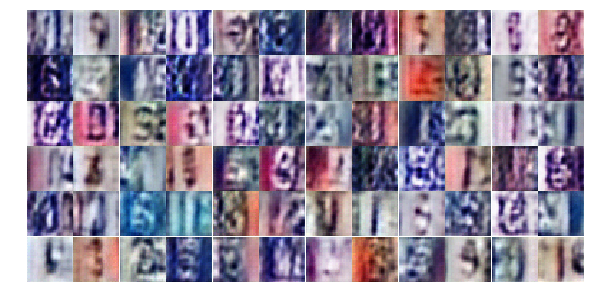

Epoch 4/30... Discriminator Loss: 0.4920... Generator Loss: 1.3915
Epoch 4/30... Discriminator Loss: 0.4793... Generator Loss: 1.4242
Epoch 4/30... Discriminator Loss: 0.4405... Generator Loss: 1.5169
Epoch 4/30... Discriminator Loss: 0.8835... Generator Loss: 0.7471
Epoch 4/30... Discriminator Loss: 0.5056... Generator Loss: 1.2985
Epoch 4/30... Discriminator Loss: 0.6123... Generator Loss: 1.4519
Epoch 4/30... Discriminator Loss: 0.5575... Generator Loss: 1.5092
Epoch 4/30... Discriminator Loss: 0.6380... Generator Loss: 1.6439
Epoch 4/30... Discriminator Loss: 0.3423... Generator Loss: 2.0404
Epoch 4/30... Discriminator Loss: 0.6313... Generator Loss: 1.1784


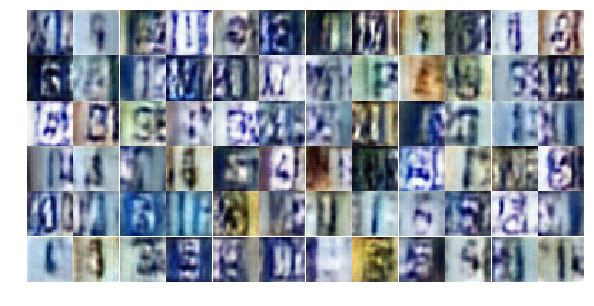

Epoch 4/30... Discriminator Loss: 0.6500... Generator Loss: 1.0547
Epoch 4/30... Discriminator Loss: 0.3901... Generator Loss: 1.6890
Epoch 4/30... Discriminator Loss: 0.2405... Generator Loss: 2.2481
Epoch 4/30... Discriminator Loss: 0.6172... Generator Loss: 2.8370
Epoch 4/30... Discriminator Loss: 0.6030... Generator Loss: 1.2351
Epoch 4/30... Discriminator Loss: 0.5165... Generator Loss: 2.2380
Epoch 4/30... Discriminator Loss: 0.8182... Generator Loss: 0.7787
Epoch 4/30... Discriminator Loss: 0.6434... Generator Loss: 2.3422
Epoch 4/30... Discriminator Loss: 0.8303... Generator Loss: 2.5926
Epoch 5/30... Discriminator Loss: 0.8370... Generator Loss: 1.1683


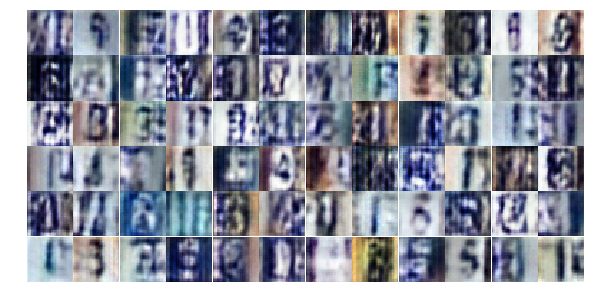

Epoch 5/30... Discriminator Loss: 0.5034... Generator Loss: 1.4376
Epoch 5/30... Discriminator Loss: 0.5236... Generator Loss: 1.4282
Epoch 5/30... Discriminator Loss: 0.4318... Generator Loss: 1.5167
Epoch 5/30... Discriminator Loss: 0.7562... Generator Loss: 0.8257
Epoch 5/30... Discriminator Loss: 0.3879... Generator Loss: 2.2849
Epoch 5/30... Discriminator Loss: 0.8077... Generator Loss: 0.8511
Epoch 5/30... Discriminator Loss: 0.7463... Generator Loss: 1.3929
Epoch 5/30... Discriminator Loss: 0.4990... Generator Loss: 1.3650
Epoch 5/30... Discriminator Loss: 0.6294... Generator Loss: 1.0863
Epoch 5/30... Discriminator Loss: 1.1616... Generator Loss: 0.4949


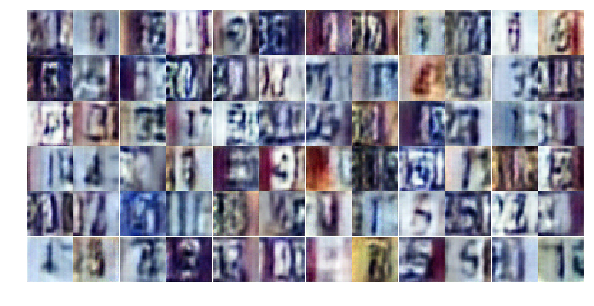

Epoch 5/30... Discriminator Loss: 1.6939... Generator Loss: 0.2772
Epoch 5/30... Discriminator Loss: 1.1776... Generator Loss: 2.8191
Epoch 5/30... Discriminator Loss: 0.5407... Generator Loss: 1.4228
Epoch 5/30... Discriminator Loss: 1.0656... Generator Loss: 0.5972
Epoch 5/30... Discriminator Loss: 0.9218... Generator Loss: 2.7160
Epoch 5/30... Discriminator Loss: 0.9197... Generator Loss: 0.7537
Epoch 5/30... Discriminator Loss: 0.6873... Generator Loss: 1.0493
Epoch 5/30... Discriminator Loss: 0.5150... Generator Loss: 1.5447
Epoch 5/30... Discriminator Loss: 0.7160... Generator Loss: 0.9980
Epoch 5/30... Discriminator Loss: 0.6035... Generator Loss: 1.2260


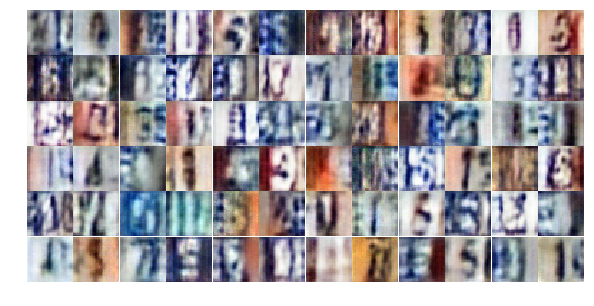

Epoch 5/30... Discriminator Loss: 0.6230... Generator Loss: 1.1153
Epoch 5/30... Discriminator Loss: 0.7412... Generator Loss: 1.1541
Epoch 5/30... Discriminator Loss: 0.7884... Generator Loss: 0.9846
Epoch 5/30... Discriminator Loss: 0.8259... Generator Loss: 0.8456
Epoch 5/30... Discriminator Loss: 0.7528... Generator Loss: 0.9278
Epoch 5/30... Discriminator Loss: 0.6969... Generator Loss: 1.0884
Epoch 5/30... Discriminator Loss: 0.8545... Generator Loss: 0.7429
Epoch 5/30... Discriminator Loss: 0.6301... Generator Loss: 1.4275
Epoch 5/30... Discriminator Loss: 0.7842... Generator Loss: 0.8265
Epoch 5/30... Discriminator Loss: 0.4872... Generator Loss: 1.3942


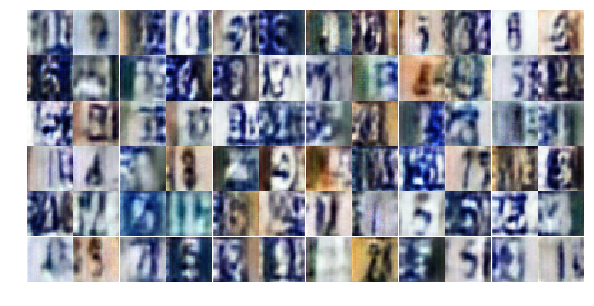

Epoch 5/30... Discriminator Loss: 1.0017... Generator Loss: 2.4645
Epoch 5/30... Discriminator Loss: 0.6050... Generator Loss: 1.1098
Epoch 5/30... Discriminator Loss: 1.0331... Generator Loss: 0.6150
Epoch 5/30... Discriminator Loss: 0.4596... Generator Loss: 1.4666
Epoch 5/30... Discriminator Loss: 0.5821... Generator Loss: 1.5584
Epoch 5/30... Discriminator Loss: 0.4556... Generator Loss: 1.6451
Epoch 5/30... Discriminator Loss: 1.0482... Generator Loss: 0.6285
Epoch 5/30... Discriminator Loss: 0.4908... Generator Loss: 1.3912
Epoch 5/30... Discriminator Loss: 0.8068... Generator Loss: 0.8012
Epoch 5/30... Discriminator Loss: 0.5158... Generator Loss: 1.5313


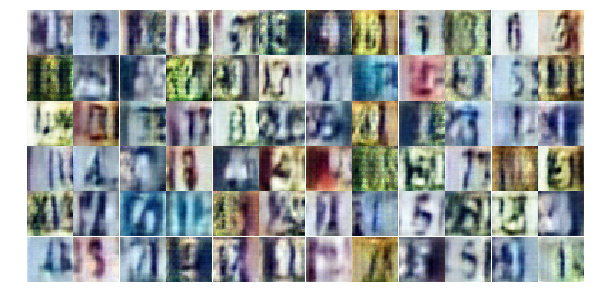

Epoch 5/30... Discriminator Loss: 0.4177... Generator Loss: 1.8066
Epoch 5/30... Discriminator Loss: 0.4978... Generator Loss: 1.2752
Epoch 5/30... Discriminator Loss: 1.0714... Generator Loss: 0.6399
Epoch 5/30... Discriminator Loss: 0.9347... Generator Loss: 0.7366
Epoch 5/30... Discriminator Loss: 1.8424... Generator Loss: 3.3268
Epoch 5/30... Discriminator Loss: 0.9663... Generator Loss: 0.7863
Epoch 5/30... Discriminator Loss: 0.6614... Generator Loss: 1.3883
Epoch 5/30... Discriminator Loss: 0.5955... Generator Loss: 1.8411
Epoch 5/30... Discriminator Loss: 0.7487... Generator Loss: 0.9122
Epoch 5/30... Discriminator Loss: 0.5168... Generator Loss: 1.5599


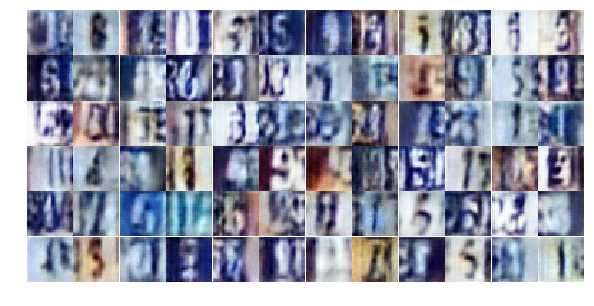

Epoch 5/30... Discriminator Loss: 0.6751... Generator Loss: 0.9320
Epoch 5/30... Discriminator Loss: 0.5985... Generator Loss: 1.9574
Epoch 5/30... Discriminator Loss: 0.8354... Generator Loss: 0.8389
Epoch 5/30... Discriminator Loss: 0.6608... Generator Loss: 1.0661
Epoch 5/30... Discriminator Loss: 0.4689... Generator Loss: 1.7167
Epoch 5/30... Discriminator Loss: 0.8233... Generator Loss: 0.8684
Epoch 6/30... Discriminator Loss: 0.6309... Generator Loss: 1.0870
Epoch 6/30... Discriminator Loss: 0.3879... Generator Loss: 1.8250
Epoch 6/30... Discriminator Loss: 0.5879... Generator Loss: 1.4184
Epoch 6/30... Discriminator Loss: 1.2187... Generator Loss: 0.4491


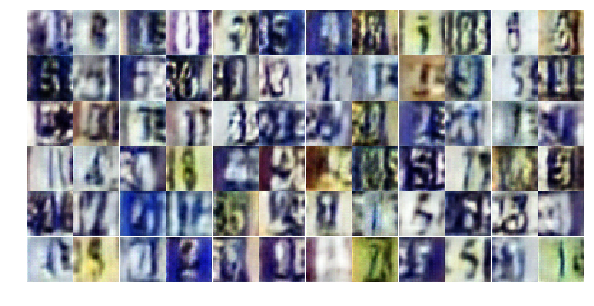

Epoch 6/30... Discriminator Loss: 0.5831... Generator Loss: 1.3222
Epoch 6/30... Discriminator Loss: 0.5960... Generator Loss: 1.1216
Epoch 6/30... Discriminator Loss: 0.8863... Generator Loss: 0.6857
Epoch 6/30... Discriminator Loss: 1.4580... Generator Loss: 3.0422
Epoch 6/30... Discriminator Loss: 1.1771... Generator Loss: 0.5894
Epoch 6/30... Discriminator Loss: 0.7669... Generator Loss: 0.8395
Epoch 6/30... Discriminator Loss: 0.5134... Generator Loss: 1.3663
Epoch 6/30... Discriminator Loss: 1.0039... Generator Loss: 0.6725
Epoch 6/30... Discriminator Loss: 0.5423... Generator Loss: 1.1842
Epoch 6/30... Discriminator Loss: 0.6199... Generator Loss: 1.9385


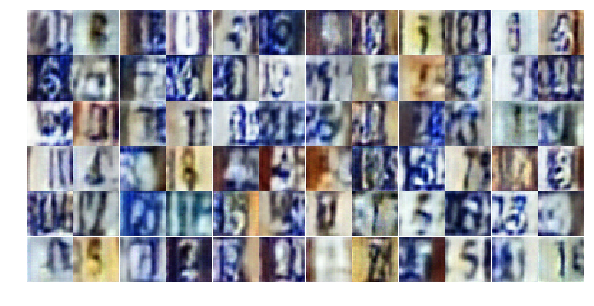

Epoch 6/30... Discriminator Loss: 0.6795... Generator Loss: 1.0782
Epoch 6/30... Discriminator Loss: 0.5302... Generator Loss: 1.5985
Epoch 6/30... Discriminator Loss: 0.5936... Generator Loss: 1.0942
Epoch 6/30... Discriminator Loss: 0.4318... Generator Loss: 1.5052
Epoch 6/30... Discriminator Loss: 0.4341... Generator Loss: 1.9287
Epoch 6/30... Discriminator Loss: 0.4742... Generator Loss: 1.5099
Epoch 6/30... Discriminator Loss: 0.4335... Generator Loss: 1.5442
Epoch 6/30... Discriminator Loss: 0.7432... Generator Loss: 0.9855
Epoch 6/30... Discriminator Loss: 0.6092... Generator Loss: 1.7546
Epoch 6/30... Discriminator Loss: 0.5420... Generator Loss: 1.5530


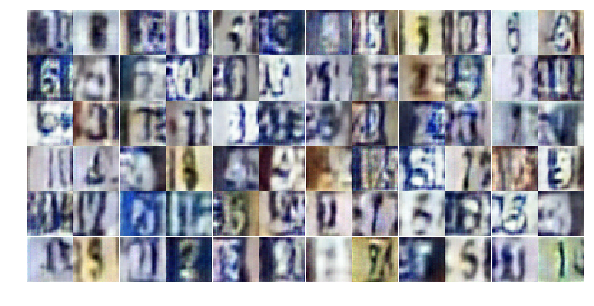

Epoch 6/30... Discriminator Loss: 0.6397... Generator Loss: 1.0534
Epoch 6/30... Discriminator Loss: 0.8556... Generator Loss: 0.7220
Epoch 6/30... Discriminator Loss: 1.1421... Generator Loss: 0.5741
Epoch 6/30... Discriminator Loss: 1.0823... Generator Loss: 0.5079
Epoch 6/30... Discriminator Loss: 0.6511... Generator Loss: 1.6545
Epoch 6/30... Discriminator Loss: 1.0054... Generator Loss: 0.7088
Epoch 6/30... Discriminator Loss: 0.8143... Generator Loss: 0.7896
Epoch 6/30... Discriminator Loss: 0.4519... Generator Loss: 1.4826
Epoch 6/30... Discriminator Loss: 0.5475... Generator Loss: 1.2249
Epoch 6/30... Discriminator Loss: 0.5504... Generator Loss: 2.0980


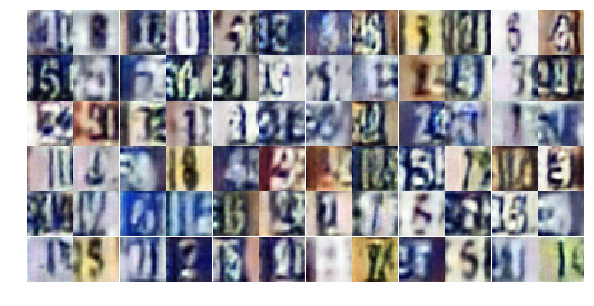

Epoch 6/30... Discriminator Loss: 1.0641... Generator Loss: 0.5590
Epoch 6/30... Discriminator Loss: 0.6022... Generator Loss: 1.1691
Epoch 6/30... Discriminator Loss: 0.6737... Generator Loss: 1.2039
Epoch 6/30... Discriminator Loss: 0.6291... Generator Loss: 1.2705
Epoch 6/30... Discriminator Loss: 0.6724... Generator Loss: 0.9157
Epoch 6/30... Discriminator Loss: 0.5578... Generator Loss: 1.3592
Epoch 6/30... Discriminator Loss: 0.4673... Generator Loss: 1.8674
Epoch 6/30... Discriminator Loss: 0.5439... Generator Loss: 1.2826
Epoch 6/30... Discriminator Loss: 0.8376... Generator Loss: 0.8505
Epoch 6/30... Discriminator Loss: 0.3948... Generator Loss: 1.5578


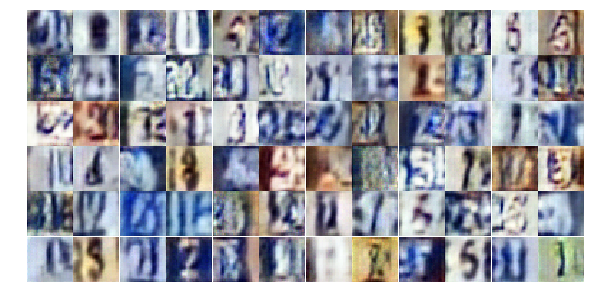

Epoch 6/30... Discriminator Loss: 2.4444... Generator Loss: 0.1534
Epoch 6/30... Discriminator Loss: 0.9769... Generator Loss: 0.7822
Epoch 6/30... Discriminator Loss: 0.8603... Generator Loss: 0.8715
Epoch 6/30... Discriminator Loss: 0.7273... Generator Loss: 2.1544
Epoch 6/30... Discriminator Loss: 0.6525... Generator Loss: 1.2709
Epoch 6/30... Discriminator Loss: 0.5512... Generator Loss: 1.3771
Epoch 6/30... Discriminator Loss: 0.8675... Generator Loss: 0.8115
Epoch 6/30... Discriminator Loss: 1.2282... Generator Loss: 0.5053
Epoch 6/30... Discriminator Loss: 0.5590... Generator Loss: 1.3549
Epoch 6/30... Discriminator Loss: 1.8106... Generator Loss: 0.2444


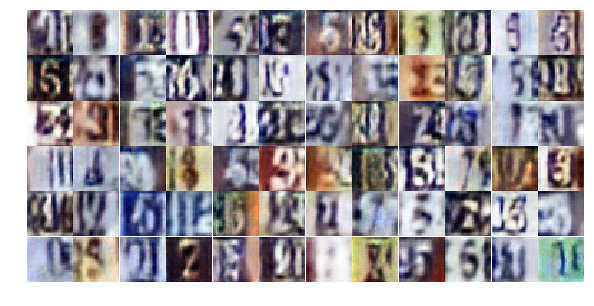

Epoch 6/30... Discriminator Loss: 0.5695... Generator Loss: 1.3043
Epoch 6/30... Discriminator Loss: 0.8502... Generator Loss: 0.7448
Epoch 6/30... Discriminator Loss: 0.5385... Generator Loss: 1.4110
Epoch 7/30... Discriminator Loss: 0.5238... Generator Loss: 1.4416
Epoch 7/30... Discriminator Loss: 0.5073... Generator Loss: 1.6652
Epoch 7/30... Discriminator Loss: 0.6077... Generator Loss: 1.3242
Epoch 7/30... Discriminator Loss: 1.0735... Generator Loss: 0.6014
Epoch 7/30... Discriminator Loss: 0.5330... Generator Loss: 1.5041
Epoch 7/30... Discriminator Loss: 0.4389... Generator Loss: 1.6225
Epoch 7/30... Discriminator Loss: 0.6667... Generator Loss: 1.0755


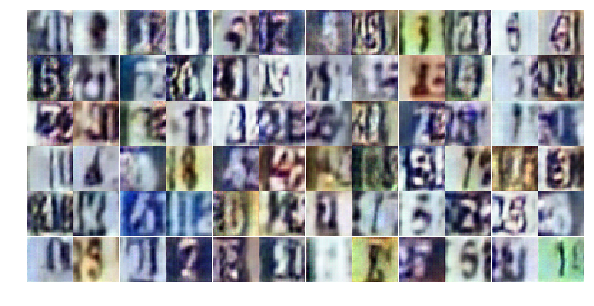

Epoch 7/30... Discriminator Loss: 0.7066... Generator Loss: 2.0134
Epoch 7/30... Discriminator Loss: 0.6067... Generator Loss: 1.2515
Epoch 7/30... Discriminator Loss: 0.8066... Generator Loss: 0.7694
Epoch 7/30... Discriminator Loss: 0.8046... Generator Loss: 0.8129
Epoch 7/30... Discriminator Loss: 0.4719... Generator Loss: 1.7056
Epoch 7/30... Discriminator Loss: 0.4373... Generator Loss: 1.5701
Epoch 7/30... Discriminator Loss: 1.2281... Generator Loss: 2.8163
Epoch 7/30... Discriminator Loss: 0.8590... Generator Loss: 1.8022
Epoch 7/30... Discriminator Loss: 0.6536... Generator Loss: 1.6723
Epoch 7/30... Discriminator Loss: 0.5332... Generator Loss: 1.4008


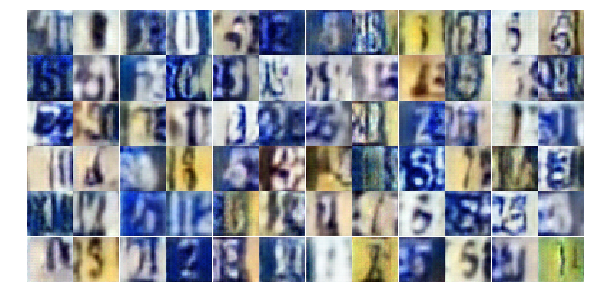

Epoch 7/30... Discriminator Loss: 0.7524... Generator Loss: 0.8866
Epoch 7/30... Discriminator Loss: 0.3964... Generator Loss: 2.4149
Epoch 7/30... Discriminator Loss: 1.2505... Generator Loss: 0.4766
Epoch 7/30... Discriminator Loss: 0.5657... Generator Loss: 1.7161
Epoch 7/30... Discriminator Loss: 0.5009... Generator Loss: 1.5331
Epoch 7/30... Discriminator Loss: 0.5491... Generator Loss: 1.3955
Epoch 7/30... Discriminator Loss: 0.9793... Generator Loss: 2.7872
Epoch 7/30... Discriminator Loss: 0.8761... Generator Loss: 0.7811
Epoch 7/30... Discriminator Loss: 0.3075... Generator Loss: 2.2029
Epoch 7/30... Discriminator Loss: 0.3865... Generator Loss: 1.8157


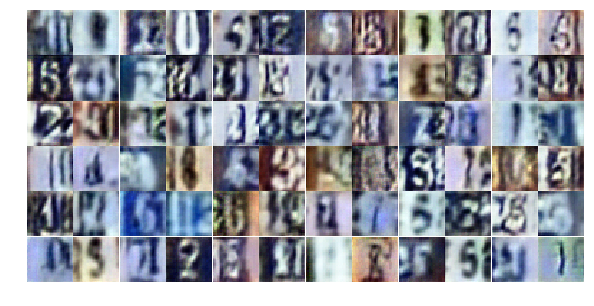

Epoch 7/30... Discriminator Loss: 1.0583... Generator Loss: 0.5517
Epoch 7/30... Discriminator Loss: 1.0033... Generator Loss: 0.6437
Epoch 7/30... Discriminator Loss: 0.4953... Generator Loss: 1.8935
Epoch 7/30... Discriminator Loss: 0.7114... Generator Loss: 1.1600
Epoch 7/30... Discriminator Loss: 0.6133... Generator Loss: 1.3225
Epoch 7/30... Discriminator Loss: 0.6053... Generator Loss: 1.5046
Epoch 7/30... Discriminator Loss: 0.5596... Generator Loss: 1.2407
Epoch 7/30... Discriminator Loss: 0.4964... Generator Loss: 1.4176
Epoch 7/30... Discriminator Loss: 0.9443... Generator Loss: 0.6755
Epoch 7/30... Discriminator Loss: 0.8450... Generator Loss: 3.1839


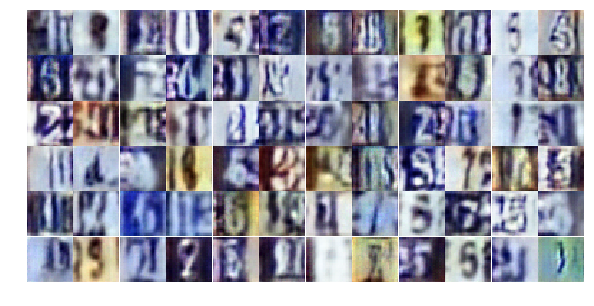

Epoch 7/30... Discriminator Loss: 0.9162... Generator Loss: 1.1348
Epoch 7/30... Discriminator Loss: 0.9636... Generator Loss: 1.4230
Epoch 7/30... Discriminator Loss: 0.5177... Generator Loss: 1.7282
Epoch 7/30... Discriminator Loss: 1.3239... Generator Loss: 0.4570
Epoch 7/30... Discriminator Loss: 0.8268... Generator Loss: 0.9358
Epoch 7/30... Discriminator Loss: 0.3898... Generator Loss: 1.7092
Epoch 7/30... Discriminator Loss: 0.3578... Generator Loss: 1.7437
Epoch 7/30... Discriminator Loss: 1.2230... Generator Loss: 0.4590
Epoch 7/30... Discriminator Loss: 0.3984... Generator Loss: 2.5785
Epoch 7/30... Discriminator Loss: 0.7018... Generator Loss: 1.1308


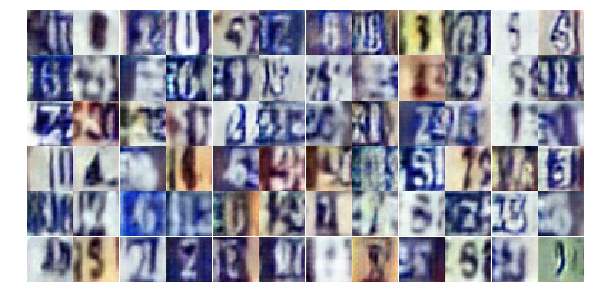

Epoch 7/30... Discriminator Loss: 0.3046... Generator Loss: 2.4382
Epoch 7/30... Discriminator Loss: 0.6931... Generator Loss: 0.9305
Epoch 7/30... Discriminator Loss: 0.7602... Generator Loss: 1.8448
Epoch 7/30... Discriminator Loss: 0.6637... Generator Loss: 2.4389
Epoch 7/30... Discriminator Loss: 1.3415... Generator Loss: 0.5027
Epoch 7/30... Discriminator Loss: 0.8231... Generator Loss: 0.9702
Epoch 7/30... Discriminator Loss: 1.5113... Generator Loss: 0.3565
Epoch 7/30... Discriminator Loss: 0.5273... Generator Loss: 1.5835
Epoch 7/30... Discriminator Loss: 1.0403... Generator Loss: 0.6679
Epoch 7/30... Discriminator Loss: 0.5469... Generator Loss: 1.1998


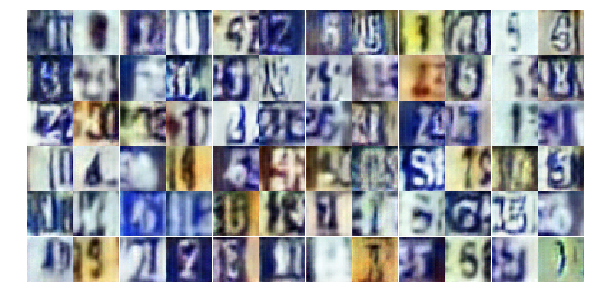

Epoch 7/30... Discriminator Loss: 0.4816... Generator Loss: 1.8235
Epoch 8/30... Discriminator Loss: 0.5669... Generator Loss: 1.3625
Epoch 8/30... Discriminator Loss: 0.6910... Generator Loss: 0.9193
Epoch 8/30... Discriminator Loss: 0.6002... Generator Loss: 1.1164
Epoch 8/30... Discriminator Loss: 0.7245... Generator Loss: 1.4187
Epoch 8/30... Discriminator Loss: 0.7879... Generator Loss: 2.0230
Epoch 8/30... Discriminator Loss: 0.8289... Generator Loss: 0.9487
Epoch 8/30... Discriminator Loss: 0.4736... Generator Loss: 1.4956
Epoch 8/30... Discriminator Loss: 0.9396... Generator Loss: 0.7077
Epoch 8/30... Discriminator Loss: 0.6297... Generator Loss: 1.3038


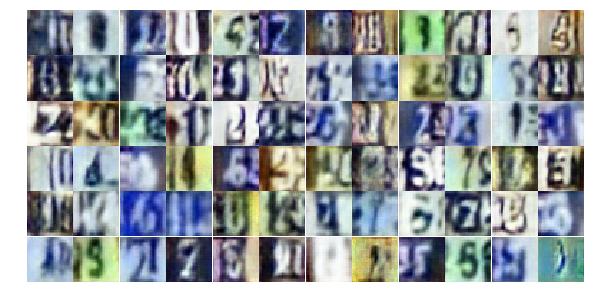

Epoch 8/30... Discriminator Loss: 0.5380... Generator Loss: 1.9932
Epoch 8/30... Discriminator Loss: 0.4183... Generator Loss: 2.3875
Epoch 8/30... Discriminator Loss: 0.5550... Generator Loss: 1.5858
Epoch 8/30... Discriminator Loss: 0.4678... Generator Loss: 1.7776
Epoch 8/30... Discriminator Loss: 0.8546... Generator Loss: 0.7352
Epoch 8/30... Discriminator Loss: 0.7784... Generator Loss: 1.9481
Epoch 8/30... Discriminator Loss: 0.3515... Generator Loss: 1.8661
Epoch 8/30... Discriminator Loss: 0.4050... Generator Loss: 1.6900
Epoch 8/30... Discriminator Loss: 0.9960... Generator Loss: 0.6481
Epoch 8/30... Discriminator Loss: 1.0423... Generator Loss: 0.6479


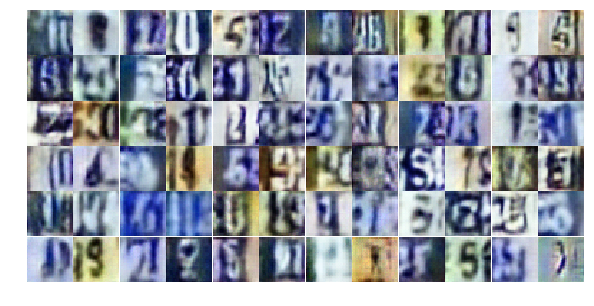

Epoch 8/30... Discriminator Loss: 0.4059... Generator Loss: 2.0500
Epoch 8/30... Discriminator Loss: 0.6670... Generator Loss: 1.0335
Epoch 8/30... Discriminator Loss: 0.5631... Generator Loss: 1.1755
Epoch 8/30... Discriminator Loss: 0.9664... Generator Loss: 1.0627
Epoch 8/30... Discriminator Loss: 0.3893... Generator Loss: 1.8994
Epoch 8/30... Discriminator Loss: 0.5238... Generator Loss: 1.4952
Epoch 8/30... Discriminator Loss: 0.5287... Generator Loss: 2.0634
Epoch 8/30... Discriminator Loss: 0.3705... Generator Loss: 1.6926
Epoch 8/30... Discriminator Loss: 0.9027... Generator Loss: 2.6669
Epoch 8/30... Discriminator Loss: 0.9963... Generator Loss: 0.7221


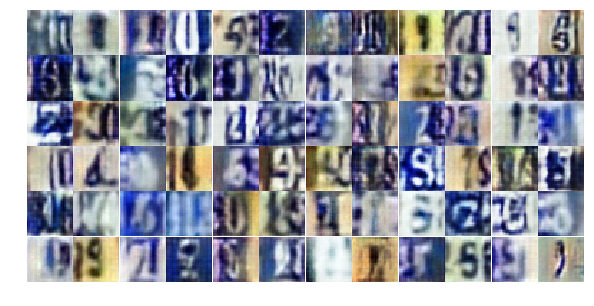

Epoch 8/30... Discriminator Loss: 0.6946... Generator Loss: 1.1275
Epoch 8/30... Discriminator Loss: 0.8335... Generator Loss: 0.8561
Epoch 8/30... Discriminator Loss: 0.5916... Generator Loss: 1.3121
Epoch 8/30... Discriminator Loss: 0.5788... Generator Loss: 1.2104
Epoch 8/30... Discriminator Loss: 1.2042... Generator Loss: 0.5372
Epoch 8/30... Discriminator Loss: 0.4751... Generator Loss: 1.3997
Epoch 8/30... Discriminator Loss: 0.5348... Generator Loss: 1.4584
Epoch 8/30... Discriminator Loss: 0.6320... Generator Loss: 1.0591
Epoch 8/30... Discriminator Loss: 0.5630... Generator Loss: 1.4602
Epoch 8/30... Discriminator Loss: 0.5343... Generator Loss: 1.2048


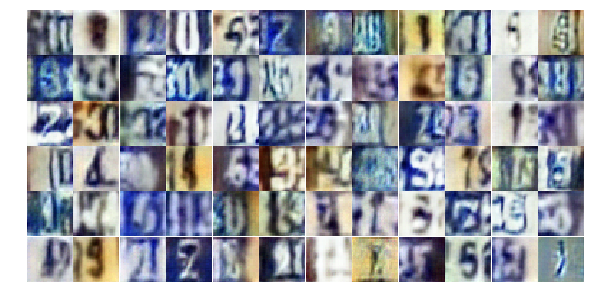

Epoch 8/30... Discriminator Loss: 0.3615... Generator Loss: 1.8341
Epoch 8/30... Discriminator Loss: 1.2499... Generator Loss: 0.5008
Epoch 8/30... Discriminator Loss: 0.6062... Generator Loss: 1.1235
Epoch 8/30... Discriminator Loss: 0.5323... Generator Loss: 1.2413
Epoch 8/30... Discriminator Loss: 0.9622... Generator Loss: 2.4779
Epoch 8/30... Discriminator Loss: 0.5867... Generator Loss: 1.4636
Epoch 8/30... Discriminator Loss: 0.4431... Generator Loss: 1.6529
Epoch 8/30... Discriminator Loss: 0.4737... Generator Loss: 1.5687
Epoch 8/30... Discriminator Loss: 0.6764... Generator Loss: 0.9819
Epoch 8/30... Discriminator Loss: 0.8199... Generator Loss: 1.9738


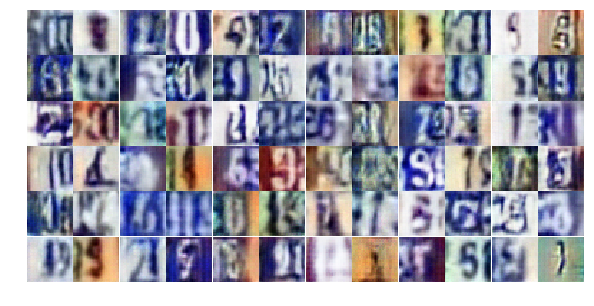

Epoch 8/30... Discriminator Loss: 0.6521... Generator Loss: 1.5109
Epoch 8/30... Discriminator Loss: 0.4506... Generator Loss: 1.4972
Epoch 8/30... Discriminator Loss: 0.6431... Generator Loss: 1.9389
Epoch 8/30... Discriminator Loss: 0.7110... Generator Loss: 1.0232
Epoch 8/30... Discriminator Loss: 0.4657... Generator Loss: 2.0200
Epoch 8/30... Discriminator Loss: 0.8169... Generator Loss: 0.8218
Epoch 8/30... Discriminator Loss: 0.5461... Generator Loss: 1.2388
Epoch 8/30... Discriminator Loss: 0.8220... Generator Loss: 2.8613
Epoch 9/30... Discriminator Loss: 1.0415... Generator Loss: 0.6336
Epoch 9/30... Discriminator Loss: 0.8851... Generator Loss: 0.7103


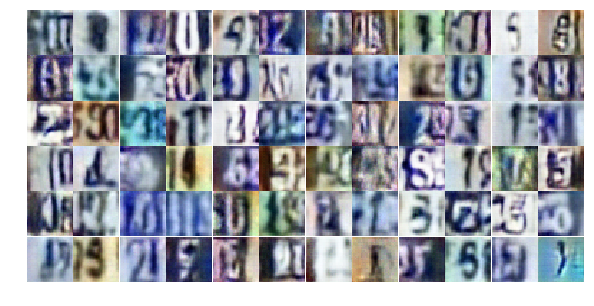

Epoch 9/30... Discriminator Loss: 0.6932... Generator Loss: 1.1278
Epoch 9/30... Discriminator Loss: 0.6093... Generator Loss: 1.2048
Epoch 9/30... Discriminator Loss: 0.9017... Generator Loss: 0.7293
Epoch 9/30... Discriminator Loss: 0.4963... Generator Loss: 1.4395
Epoch 9/30... Discriminator Loss: 0.9051... Generator Loss: 0.7933
Epoch 9/30... Discriminator Loss: 0.4644... Generator Loss: 1.8228
Epoch 9/30... Discriminator Loss: 0.7241... Generator Loss: 1.5433
Epoch 9/30... Discriminator Loss: 0.6171... Generator Loss: 1.0616
Epoch 9/30... Discriminator Loss: 0.9155... Generator Loss: 0.7416
Epoch 9/30... Discriminator Loss: 0.5489... Generator Loss: 1.2061


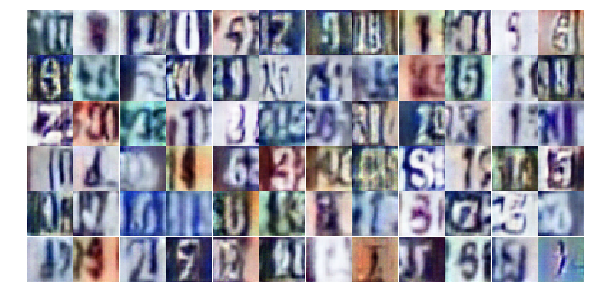

Epoch 9/30... Discriminator Loss: 1.2760... Generator Loss: 0.4147
Epoch 9/30... Discriminator Loss: 0.7977... Generator Loss: 0.9878
Epoch 9/30... Discriminator Loss: 0.8320... Generator Loss: 0.8716
Epoch 9/30... Discriminator Loss: 0.7161... Generator Loss: 1.7436
Epoch 9/30... Discriminator Loss: 0.5240... Generator Loss: 1.5385
Epoch 9/30... Discriminator Loss: 0.8899... Generator Loss: 1.0433
Epoch 9/30... Discriminator Loss: 0.7391... Generator Loss: 0.9477
Epoch 9/30... Discriminator Loss: 0.7555... Generator Loss: 1.0070
Epoch 9/30... Discriminator Loss: 1.1740... Generator Loss: 0.5385
Epoch 9/30... Discriminator Loss: 1.1468... Generator Loss: 0.5378


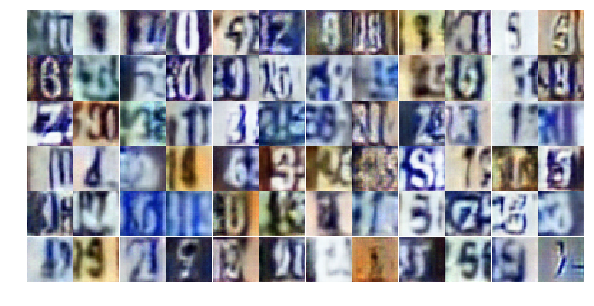

Epoch 9/30... Discriminator Loss: 0.7871... Generator Loss: 1.9236
Epoch 9/30... Discriminator Loss: 0.6857... Generator Loss: 1.0337
Epoch 9/30... Discriminator Loss: 0.5772... Generator Loss: 1.3186
Epoch 9/30... Discriminator Loss: 0.5952... Generator Loss: 1.1846
Epoch 9/30... Discriminator Loss: 0.6399... Generator Loss: 1.6101
Epoch 9/30... Discriminator Loss: 1.2485... Generator Loss: 3.1342
Epoch 9/30... Discriminator Loss: 1.0374... Generator Loss: 0.7708
Epoch 9/30... Discriminator Loss: 0.4810... Generator Loss: 1.6904
Epoch 9/30... Discriminator Loss: 0.4475... Generator Loss: 1.4636
Epoch 9/30... Discriminator Loss: 0.5894... Generator Loss: 1.1259


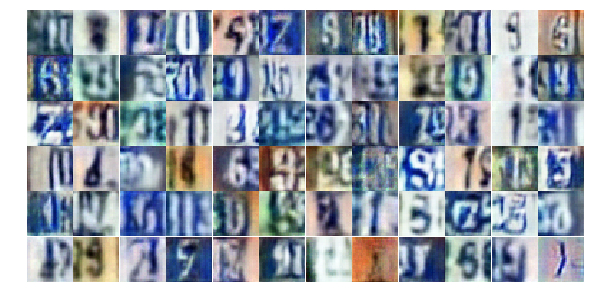

Epoch 9/30... Discriminator Loss: 0.5189... Generator Loss: 1.3038
Epoch 9/30... Discriminator Loss: 0.5774... Generator Loss: 1.3638
Epoch 9/30... Discriminator Loss: 0.8608... Generator Loss: 0.7946
Epoch 9/30... Discriminator Loss: 0.7585... Generator Loss: 0.9206
Epoch 9/30... Discriminator Loss: 0.5176... Generator Loss: 1.4474
Epoch 9/30... Discriminator Loss: 0.5019... Generator Loss: 1.8840
Epoch 9/30... Discriminator Loss: 0.4993... Generator Loss: 1.3920
Epoch 9/30... Discriminator Loss: 0.4638... Generator Loss: 1.8120
Epoch 9/30... Discriminator Loss: 0.9253... Generator Loss: 0.6987
Epoch 9/30... Discriminator Loss: 0.6889... Generator Loss: 0.9690


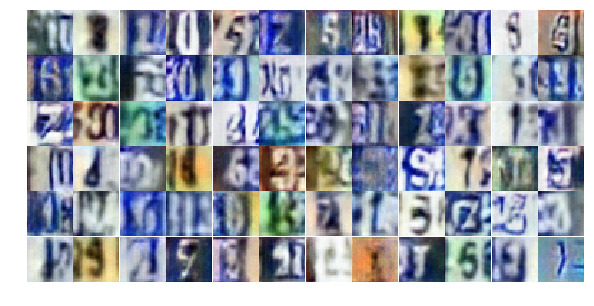

Epoch 9/30... Discriminator Loss: 0.6207... Generator Loss: 1.0692
Epoch 9/30... Discriminator Loss: 0.6109... Generator Loss: 1.2139
Epoch 9/30... Discriminator Loss: 0.5948... Generator Loss: 1.7865
Epoch 9/30... Discriminator Loss: 0.7352... Generator Loss: 1.1105
Epoch 9/30... Discriminator Loss: 0.4458... Generator Loss: 1.6873
Epoch 9/30... Discriminator Loss: 0.8907... Generator Loss: 0.7062
Epoch 9/30... Discriminator Loss: 1.3403... Generator Loss: 3.7371
Epoch 9/30... Discriminator Loss: 0.8960... Generator Loss: 0.8326
Epoch 9/30... Discriminator Loss: 0.6524... Generator Loss: 1.1828
Epoch 9/30... Discriminator Loss: 0.6193... Generator Loss: 2.0930


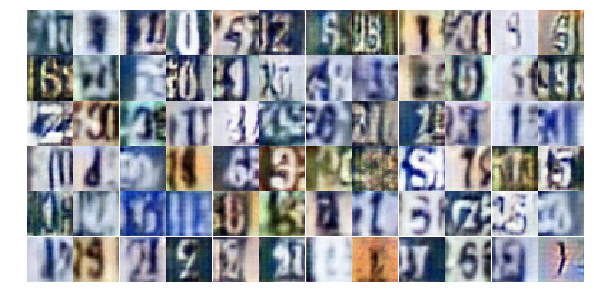

Epoch 9/30... Discriminator Loss: 1.1331... Generator Loss: 0.5474
Epoch 9/30... Discriminator Loss: 0.8566... Generator Loss: 3.1841
Epoch 9/30... Discriminator Loss: 0.8308... Generator Loss: 0.8774
Epoch 9/30... Discriminator Loss: 1.0745... Generator Loss: 0.5668
Epoch 9/30... Discriminator Loss: 0.7443... Generator Loss: 0.9459
Epoch 10/30... Discriminator Loss: 0.5284... Generator Loss: 1.4553
Epoch 10/30... Discriminator Loss: 0.6074... Generator Loss: 1.2032
Epoch 10/30... Discriminator Loss: 0.5389... Generator Loss: 1.2965
Epoch 10/30... Discriminator Loss: 0.6129... Generator Loss: 1.2745
Epoch 10/30... Discriminator Loss: 1.5804... Generator Loss: 0.3010


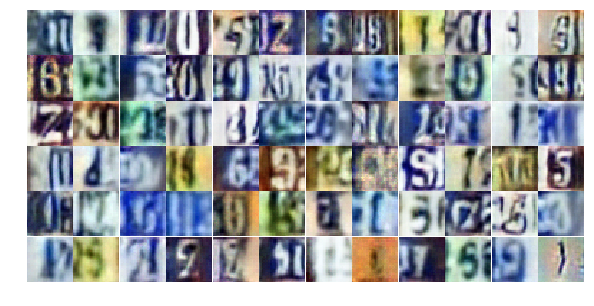

Epoch 10/30... Discriminator Loss: 1.2229... Generator Loss: 0.6535
Epoch 10/30... Discriminator Loss: 0.5811... Generator Loss: 1.3031
Epoch 10/30... Discriminator Loss: 0.5500... Generator Loss: 1.3597
Epoch 10/30... Discriminator Loss: 0.6108... Generator Loss: 1.7439
Epoch 10/30... Discriminator Loss: 0.6256... Generator Loss: 1.1006
Epoch 10/30... Discriminator Loss: 0.6962... Generator Loss: 1.2374
Epoch 10/30... Discriminator Loss: 0.5035... Generator Loss: 1.2551
Epoch 10/30... Discriminator Loss: 1.3853... Generator Loss: 0.3960
Epoch 10/30... Discriminator Loss: 0.8639... Generator Loss: 0.8824
Epoch 10/30... Discriminator Loss: 0.6112... Generator Loss: 1.3553


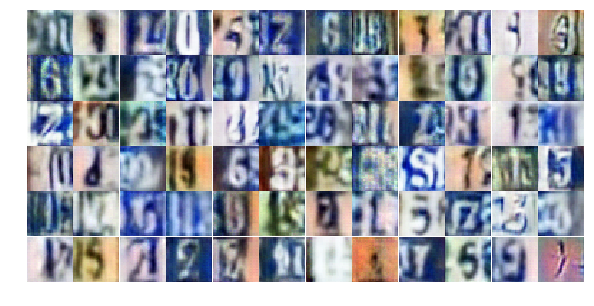

Epoch 10/30... Discriminator Loss: 1.0792... Generator Loss: 0.8423
Epoch 10/30... Discriminator Loss: 1.3212... Generator Loss: 0.4083
Epoch 10/30... Discriminator Loss: 0.6042... Generator Loss: 1.0906
Epoch 10/30... Discriminator Loss: 0.9953... Generator Loss: 0.6786
Epoch 10/30... Discriminator Loss: 0.7319... Generator Loss: 2.0585
Epoch 10/30... Discriminator Loss: 0.6353... Generator Loss: 1.0931
Epoch 10/30... Discriminator Loss: 0.9169... Generator Loss: 0.6636
Epoch 10/30... Discriminator Loss: 0.4731... Generator Loss: 1.3531
Epoch 10/30... Discriminator Loss: 0.6144... Generator Loss: 1.0620
Epoch 10/30... Discriminator Loss: 0.5573... Generator Loss: 3.2287


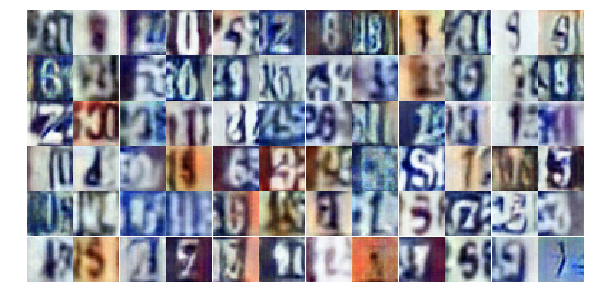

Epoch 10/30... Discriminator Loss: 1.3819... Generator Loss: 0.4096
Epoch 10/30... Discriminator Loss: 0.5888... Generator Loss: 1.2588
Epoch 10/30... Discriminator Loss: 0.4096... Generator Loss: 1.5345
Epoch 10/30... Discriminator Loss: 0.4530... Generator Loss: 1.5557
Epoch 10/30... Discriminator Loss: 1.3595... Generator Loss: 0.3705
Epoch 10/30... Discriminator Loss: 0.7128... Generator Loss: 0.9323
Epoch 10/30... Discriminator Loss: 0.3589... Generator Loss: 1.7141
Epoch 10/30... Discriminator Loss: 0.6209... Generator Loss: 1.3999
Epoch 10/30... Discriminator Loss: 0.8160... Generator Loss: 0.8090
Epoch 10/30... Discriminator Loss: 0.4982... Generator Loss: 1.6231


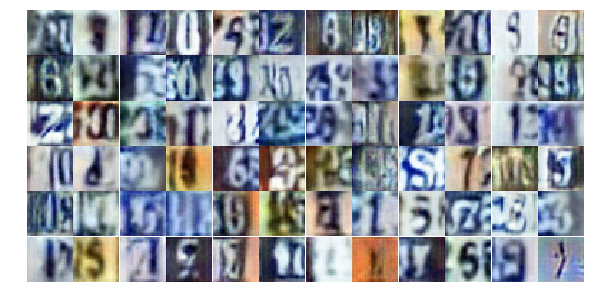

Epoch 10/30... Discriminator Loss: 0.5140... Generator Loss: 1.9712
Epoch 10/30... Discriminator Loss: 0.7766... Generator Loss: 0.9008
Epoch 10/30... Discriminator Loss: 0.5009... Generator Loss: 1.6851
Epoch 10/30... Discriminator Loss: 0.8358... Generator Loss: 1.0732
Epoch 10/30... Discriminator Loss: 0.6019... Generator Loss: 1.2164
Epoch 10/30... Discriminator Loss: 0.5525... Generator Loss: 1.4872
Epoch 10/30... Discriminator Loss: 0.6930... Generator Loss: 0.9962
Epoch 10/30... Discriminator Loss: 0.6532... Generator Loss: 0.9561
Epoch 10/30... Discriminator Loss: 0.6197... Generator Loss: 1.0597
Epoch 10/30... Discriminator Loss: 0.6257... Generator Loss: 1.2554


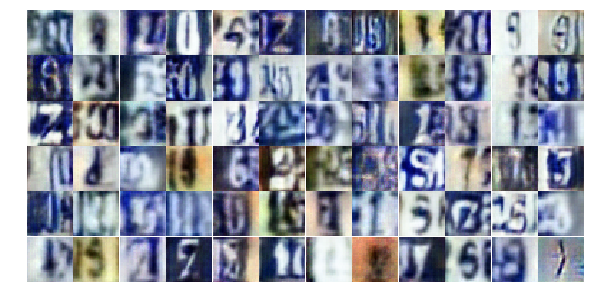

Epoch 10/30... Discriminator Loss: 0.6228... Generator Loss: 1.1167
Epoch 10/30... Discriminator Loss: 0.7511... Generator Loss: 0.9970
Epoch 10/30... Discriminator Loss: 0.8135... Generator Loss: 0.7939
Epoch 10/30... Discriminator Loss: 0.8275... Generator Loss: 0.7757
Epoch 10/30... Discriminator Loss: 0.5345... Generator Loss: 1.4152
Epoch 10/30... Discriminator Loss: 0.8257... Generator Loss: 2.1340
Epoch 10/30... Discriminator Loss: 0.6384... Generator Loss: 1.2702
Epoch 10/30... Discriminator Loss: 0.5288... Generator Loss: 1.2954
Epoch 10/30... Discriminator Loss: 0.6111... Generator Loss: 1.8698
Epoch 10/30... Discriminator Loss: 0.6144... Generator Loss: 1.4855


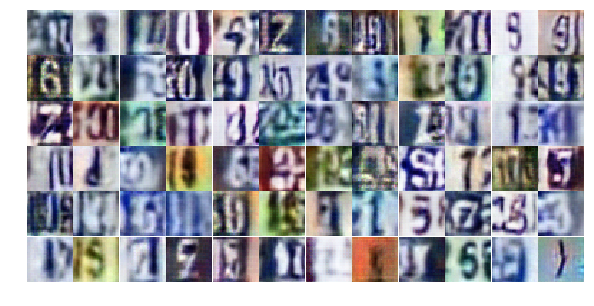

Epoch 10/30... Discriminator Loss: 0.6690... Generator Loss: 1.0353
Epoch 10/30... Discriminator Loss: 0.5108... Generator Loss: 1.3770
Epoch 10/30... Discriminator Loss: 0.4761... Generator Loss: 1.3483
Epoch 11/30... Discriminator Loss: 0.8757... Generator Loss: 0.7713
Epoch 11/30... Discriminator Loss: 0.4819... Generator Loss: 1.6105
Epoch 11/30... Discriminator Loss: 1.0949... Generator Loss: 0.5721
Epoch 11/30... Discriminator Loss: 1.0290... Generator Loss: 0.5847
Epoch 11/30... Discriminator Loss: 1.0433... Generator Loss: 1.3204
Epoch 11/30... Discriminator Loss: 1.4567... Generator Loss: 0.3665
Epoch 11/30... Discriminator Loss: 0.5148... Generator Loss: 1.5589


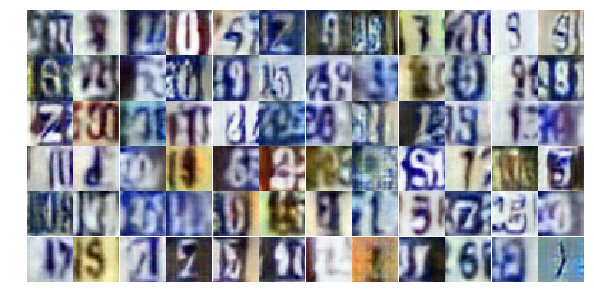

Epoch 11/30... Discriminator Loss: 0.4650... Generator Loss: 1.4181
Epoch 11/30... Discriminator Loss: 0.7293... Generator Loss: 0.8886
Epoch 11/30... Discriminator Loss: 0.5117... Generator Loss: 1.3628
Epoch 11/30... Discriminator Loss: 0.7402... Generator Loss: 0.9739
Epoch 11/30... Discriminator Loss: 0.7126... Generator Loss: 1.0118
Epoch 11/30... Discriminator Loss: 0.5567... Generator Loss: 1.3443
Epoch 11/30... Discriminator Loss: 0.6416... Generator Loss: 1.2237
Epoch 11/30... Discriminator Loss: 0.3102... Generator Loss: 1.9294
Epoch 11/30... Discriminator Loss: 0.7104... Generator Loss: 0.9750
Epoch 11/30... Discriminator Loss: 1.7760... Generator Loss: 0.3775


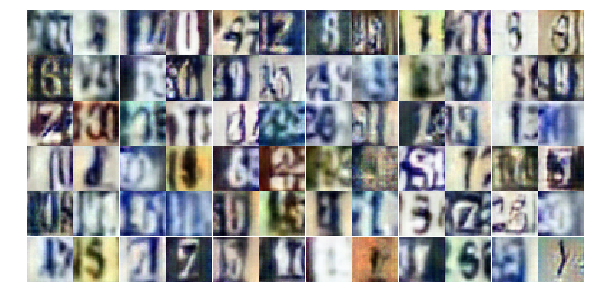

Epoch 11/30... Discriminator Loss: 1.2261... Generator Loss: 0.4779
Epoch 11/30... Discriminator Loss: 0.4135... Generator Loss: 2.4666
Epoch 11/30... Discriminator Loss: 0.8657... Generator Loss: 0.8028
Epoch 11/30... Discriminator Loss: 0.7046... Generator Loss: 1.0475
Epoch 11/30... Discriminator Loss: 0.3690... Generator Loss: 2.1266
Epoch 11/30... Discriminator Loss: 0.5671... Generator Loss: 1.4185
Epoch 11/30... Discriminator Loss: 0.5639... Generator Loss: 1.3139
Epoch 11/30... Discriminator Loss: 1.2030... Generator Loss: 0.5179
Epoch 11/30... Discriminator Loss: 0.4899... Generator Loss: 1.3785
Epoch 11/30... Discriminator Loss: 0.9549... Generator Loss: 0.7041


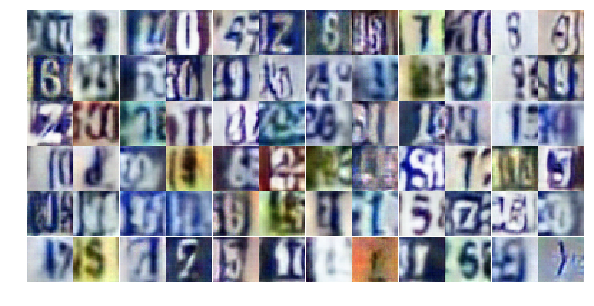

Epoch 11/30... Discriminator Loss: 0.7723... Generator Loss: 0.8954
Epoch 11/30... Discriminator Loss: 0.6014... Generator Loss: 1.2908
Epoch 11/30... Discriminator Loss: 0.7963... Generator Loss: 0.9109
Epoch 11/30... Discriminator Loss: 0.4717... Generator Loss: 1.4513
Epoch 11/30... Discriminator Loss: 1.0878... Generator Loss: 0.5865
Epoch 11/30... Discriminator Loss: 1.2562... Generator Loss: 0.4832
Epoch 11/30... Discriminator Loss: 1.1312... Generator Loss: 0.5560
Epoch 11/30... Discriminator Loss: 1.2574... Generator Loss: 0.4684
Epoch 11/30... Discriminator Loss: 0.5395... Generator Loss: 1.2818
Epoch 11/30... Discriminator Loss: 1.2955... Generator Loss: 0.4538


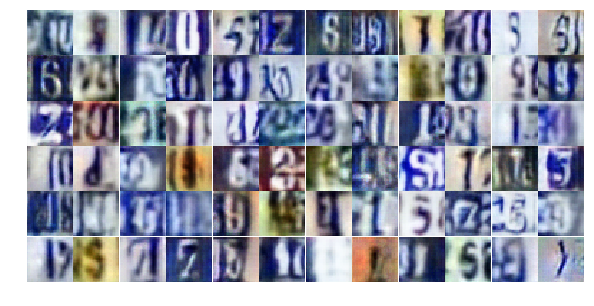

Epoch 11/30... Discriminator Loss: 0.4368... Generator Loss: 1.5727
Epoch 11/30... Discriminator Loss: 0.5588... Generator Loss: 1.3110
Epoch 11/30... Discriminator Loss: 0.7019... Generator Loss: 0.9601
Epoch 11/30... Discriminator Loss: 0.9440... Generator Loss: 0.6551
Epoch 11/30... Discriminator Loss: 0.8714... Generator Loss: 0.7740
Epoch 11/30... Discriminator Loss: 0.5878... Generator Loss: 1.3848
Epoch 11/30... Discriminator Loss: 0.5372... Generator Loss: 1.3852
Epoch 11/30... Discriminator Loss: 0.5169... Generator Loss: 2.1150
Epoch 11/30... Discriminator Loss: 1.5220... Generator Loss: 0.5206
Epoch 11/30... Discriminator Loss: 0.6336... Generator Loss: 1.2197


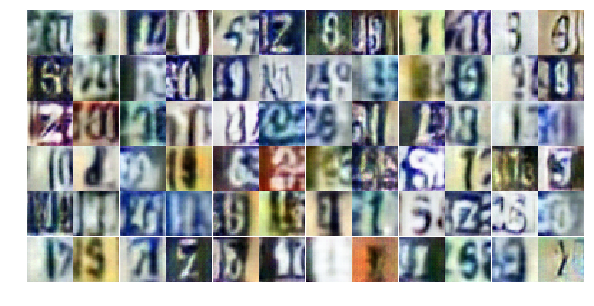

Epoch 11/30... Discriminator Loss: 0.6320... Generator Loss: 1.1779
Epoch 11/30... Discriminator Loss: 0.3959... Generator Loss: 1.7216
Epoch 11/30... Discriminator Loss: 0.6852... Generator Loss: 1.1256
Epoch 11/30... Discriminator Loss: 0.7067... Generator Loss: 0.9068
Epoch 11/30... Discriminator Loss: 1.6709... Generator Loss: 0.3291
Epoch 11/30... Discriminator Loss: 1.3507... Generator Loss: 0.5422
Epoch 11/30... Discriminator Loss: 1.1044... Generator Loss: 0.7227
Epoch 11/30... Discriminator Loss: 0.7171... Generator Loss: 2.0553
Epoch 11/30... Discriminator Loss: 0.9691... Generator Loss: 0.6805
Epoch 11/30... Discriminator Loss: 0.5656... Generator Loss: 1.3088


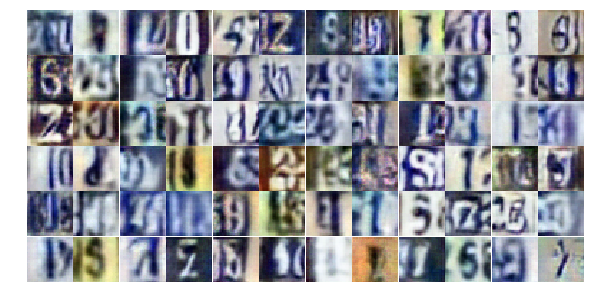

Epoch 12/30... Discriminator Loss: 0.7569... Generator Loss: 1.1467
Epoch 12/30... Discriminator Loss: 0.6529... Generator Loss: 1.0985
Epoch 12/30... Discriminator Loss: 1.1235... Generator Loss: 0.6003
Epoch 12/30... Discriminator Loss: 0.6515... Generator Loss: 1.6985
Epoch 12/30... Discriminator Loss: 0.5286... Generator Loss: 1.2947
Epoch 12/30... Discriminator Loss: 1.0310... Generator Loss: 0.5897
Epoch 12/30... Discriminator Loss: 0.7321... Generator Loss: 1.0091
Epoch 12/30... Discriminator Loss: 0.7201... Generator Loss: 1.0321
Epoch 12/30... Discriminator Loss: 0.8056... Generator Loss: 1.3198
Epoch 12/30... Discriminator Loss: 1.5463... Generator Loss: 0.3663


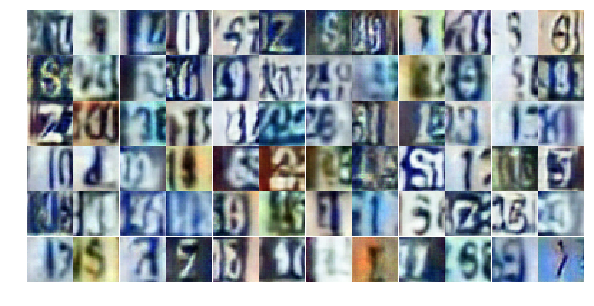

Epoch 12/30... Discriminator Loss: 0.4646... Generator Loss: 2.1012
Epoch 12/30... Discriminator Loss: 0.7192... Generator Loss: 1.1271
Epoch 12/30... Discriminator Loss: 0.5507... Generator Loss: 1.2942
Epoch 12/30... Discriminator Loss: 0.5801... Generator Loss: 1.4536
Epoch 12/30... Discriminator Loss: 0.5807... Generator Loss: 1.3479
Epoch 12/30... Discriminator Loss: 0.8019... Generator Loss: 0.9234
Epoch 12/30... Discriminator Loss: 1.9202... Generator Loss: 0.1973
Epoch 12/30... Discriminator Loss: 0.4684... Generator Loss: 1.7032
Epoch 12/30... Discriminator Loss: 0.7717... Generator Loss: 0.9908
Epoch 12/30... Discriminator Loss: 0.8395... Generator Loss: 0.8364


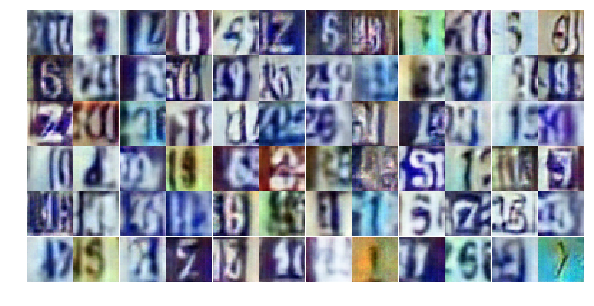

Epoch 12/30... Discriminator Loss: 0.4681... Generator Loss: 1.2290
Epoch 12/30... Discriminator Loss: 0.4749... Generator Loss: 1.3533
Epoch 12/30... Discriminator Loss: 0.6554... Generator Loss: 1.1455
Epoch 12/30... Discriminator Loss: 0.4809... Generator Loss: 1.4481
Epoch 12/30... Discriminator Loss: 0.4299... Generator Loss: 1.7162
Epoch 12/30... Discriminator Loss: 0.4818... Generator Loss: 1.4207
Epoch 12/30... Discriminator Loss: 0.5772... Generator Loss: 1.1740
Epoch 12/30... Discriminator Loss: 0.3671... Generator Loss: 1.8951
Epoch 12/30... Discriminator Loss: 0.5561... Generator Loss: 1.3177
Epoch 12/30... Discriminator Loss: 0.9307... Generator Loss: 0.6688


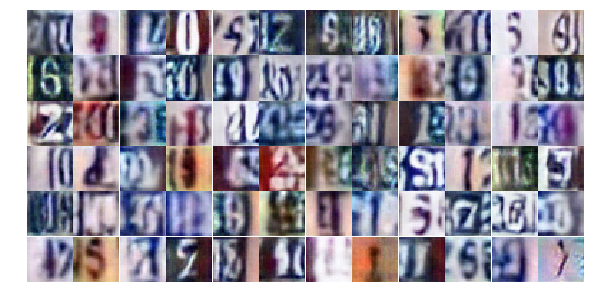

Epoch 12/30... Discriminator Loss: 0.7080... Generator Loss: 0.9818
Epoch 12/30... Discriminator Loss: 0.6753... Generator Loss: 1.4872
Epoch 12/30... Discriminator Loss: 0.9035... Generator Loss: 0.7387
Epoch 12/30... Discriminator Loss: 1.6865... Generator Loss: 0.2558
Epoch 12/30... Discriminator Loss: 0.6321... Generator Loss: 1.3926
Epoch 12/30... Discriminator Loss: 0.7675... Generator Loss: 1.0104
Epoch 12/30... Discriminator Loss: 1.1123... Generator Loss: 0.5397
Epoch 12/30... Discriminator Loss: 0.7187... Generator Loss: 1.2852
Epoch 12/30... Discriminator Loss: 0.5404... Generator Loss: 1.5036
Epoch 12/30... Discriminator Loss: 0.4326... Generator Loss: 1.4917


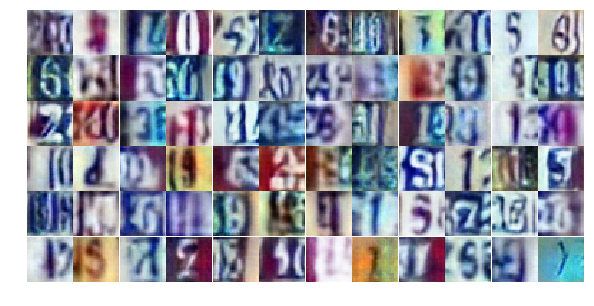

Epoch 12/30... Discriminator Loss: 0.8263... Generator Loss: 0.7994
Epoch 12/30... Discriminator Loss: 0.4240... Generator Loss: 2.1041
Epoch 12/30... Discriminator Loss: 0.4833... Generator Loss: 1.5076
Epoch 12/30... Discriminator Loss: 0.7279... Generator Loss: 1.0347
Epoch 12/30... Discriminator Loss: 0.6984... Generator Loss: 0.9525
Epoch 12/30... Discriminator Loss: 1.8918... Generator Loss: 0.4141
Epoch 12/30... Discriminator Loss: 0.8646... Generator Loss: 0.9344
Epoch 12/30... Discriminator Loss: 1.0411... Generator Loss: 0.6812
Epoch 12/30... Discriminator Loss: 0.5975... Generator Loss: 1.8734
Epoch 12/30... Discriminator Loss: 0.8534... Generator Loss: 0.7694


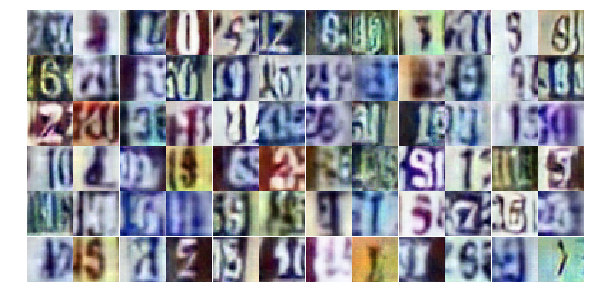

Epoch 12/30... Discriminator Loss: 0.7297... Generator Loss: 1.1257
Epoch 12/30... Discriminator Loss: 0.6468... Generator Loss: 1.1450
Epoch 12/30... Discriminator Loss: 0.8074... Generator Loss: 1.0227
Epoch 12/30... Discriminator Loss: 1.1386... Generator Loss: 0.5653
Epoch 12/30... Discriminator Loss: 0.6740... Generator Loss: 0.9845
Epoch 12/30... Discriminator Loss: 0.9240... Generator Loss: 1.0462
Epoch 12/30... Discriminator Loss: 0.7963... Generator Loss: 0.9260
Epoch 13/30... Discriminator Loss: 0.5789... Generator Loss: 1.2813
Epoch 13/30... Discriminator Loss: 0.4627... Generator Loss: 1.5035
Epoch 13/30... Discriminator Loss: 0.9482... Generator Loss: 0.6436


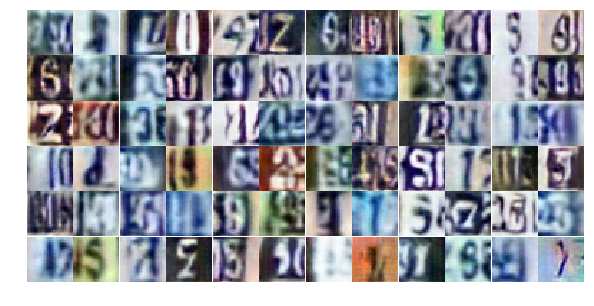

Epoch 13/30... Discriminator Loss: 0.6435... Generator Loss: 1.0717
Epoch 13/30... Discriminator Loss: 0.5702... Generator Loss: 1.4021
Epoch 13/30... Discriminator Loss: 1.5755... Generator Loss: 0.3232
Epoch 13/30... Discriminator Loss: 1.4482... Generator Loss: 0.3616
Epoch 13/30... Discriminator Loss: 1.0034... Generator Loss: 0.7160
Epoch 13/30... Discriminator Loss: 0.7055... Generator Loss: 1.1593
Epoch 13/30... Discriminator Loss: 0.4908... Generator Loss: 1.6578
Epoch 13/30... Discriminator Loss: 0.5684... Generator Loss: 1.1639
Epoch 13/30... Discriminator Loss: 0.7356... Generator Loss: 0.8821
Epoch 13/30... Discriminator Loss: 0.5987... Generator Loss: 1.2055


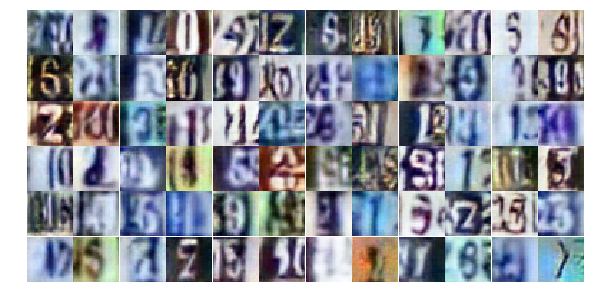

Epoch 13/30... Discriminator Loss: 0.8688... Generator Loss: 0.8427
Epoch 13/30... Discriminator Loss: 0.4867... Generator Loss: 1.5430
Epoch 13/30... Discriminator Loss: 1.1637... Generator Loss: 0.5100
Epoch 13/30... Discriminator Loss: 0.6637... Generator Loss: 1.0870
Epoch 13/30... Discriminator Loss: 0.7351... Generator Loss: 1.1871
Epoch 13/30... Discriminator Loss: 1.0306... Generator Loss: 0.6312
Epoch 13/30... Discriminator Loss: 0.6683... Generator Loss: 1.1994
Epoch 13/30... Discriminator Loss: 1.0508... Generator Loss: 0.6188
Epoch 13/30... Discriminator Loss: 0.6942... Generator Loss: 1.2233
Epoch 13/30... Discriminator Loss: 0.7576... Generator Loss: 0.8633


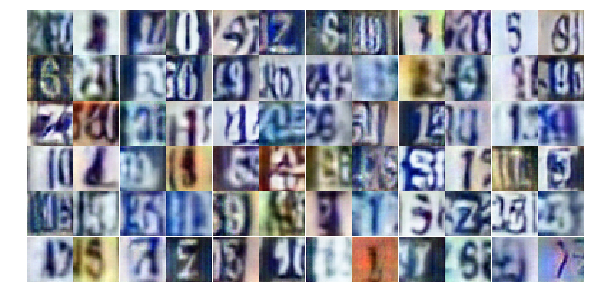

Epoch 13/30... Discriminator Loss: 0.6488... Generator Loss: 1.0246
Epoch 13/30... Discriminator Loss: 0.7162... Generator Loss: 1.2054
Epoch 13/30... Discriminator Loss: 0.5837... Generator Loss: 1.9480
Epoch 13/30... Discriminator Loss: 0.7190... Generator Loss: 0.9810
Epoch 13/30... Discriminator Loss: 0.5404... Generator Loss: 1.3824
Epoch 13/30... Discriminator Loss: 0.6618... Generator Loss: 1.1655
Epoch 13/30... Discriminator Loss: 0.9485... Generator Loss: 2.7775
Epoch 13/30... Discriminator Loss: 0.5366... Generator Loss: 1.2876
Epoch 13/30... Discriminator Loss: 0.6631... Generator Loss: 1.0226
Epoch 13/30... Discriminator Loss: 0.7345... Generator Loss: 1.0138


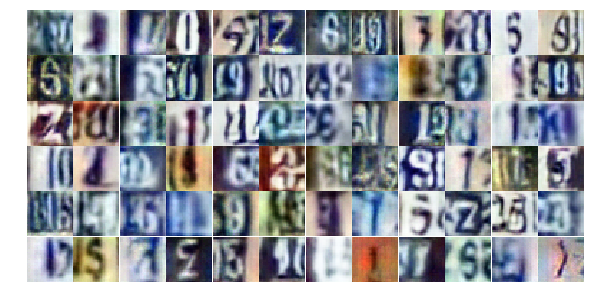

Epoch 13/30... Discriminator Loss: 0.8520... Generator Loss: 0.9667
Epoch 13/30... Discriminator Loss: 0.7069... Generator Loss: 1.8924
Epoch 13/30... Discriminator Loss: 0.9993... Generator Loss: 0.6869
Epoch 13/30... Discriminator Loss: 1.1475... Generator Loss: 0.5514
Epoch 13/30... Discriminator Loss: 0.5485... Generator Loss: 1.3112
Epoch 13/30... Discriminator Loss: 0.4145... Generator Loss: 1.9631
Epoch 13/30... Discriminator Loss: 0.6105... Generator Loss: 1.0359
Epoch 13/30... Discriminator Loss: 1.2569... Generator Loss: 0.4915
Epoch 13/30... Discriminator Loss: 0.6635... Generator Loss: 1.1180
Epoch 13/30... Discriminator Loss: 0.7095... Generator Loss: 0.9777


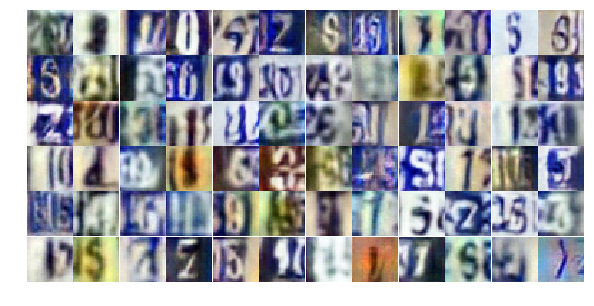

Epoch 13/30... Discriminator Loss: 0.5462... Generator Loss: 1.3999
Epoch 13/30... Discriminator Loss: 0.7483... Generator Loss: 1.0376
Epoch 13/30... Discriminator Loss: 0.9942... Generator Loss: 0.7592
Epoch 13/30... Discriminator Loss: 0.6169... Generator Loss: 1.4824
Epoch 13/30... Discriminator Loss: 0.9842... Generator Loss: 0.6997
Epoch 13/30... Discriminator Loss: 0.5494... Generator Loss: 1.3348
Epoch 13/30... Discriminator Loss: 1.0113... Generator Loss: 0.6658
Epoch 13/30... Discriminator Loss: 0.5900... Generator Loss: 1.1321
Epoch 13/30... Discriminator Loss: 1.2147... Generator Loss: 0.4682
Epoch 13/30... Discriminator Loss: 0.8685... Generator Loss: 0.7318


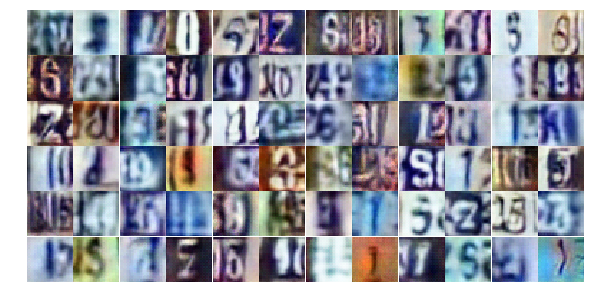

Epoch 13/30... Discriminator Loss: 0.4127... Generator Loss: 1.6415
Epoch 13/30... Discriminator Loss: 1.2768... Generator Loss: 0.4375
Epoch 13/30... Discriminator Loss: 0.9233... Generator Loss: 0.7401
Epoch 13/30... Discriminator Loss: 0.7602... Generator Loss: 2.0046
Epoch 14/30... Discriminator Loss: 1.0279... Generator Loss: 0.7371
Epoch 14/30... Discriminator Loss: 0.7673... Generator Loss: 0.9243
Epoch 14/30... Discriminator Loss: 0.9352... Generator Loss: 0.8864
Epoch 14/30... Discriminator Loss: 0.6335... Generator Loss: 1.4864
Epoch 14/30... Discriminator Loss: 0.5642... Generator Loss: 1.2469
Epoch 14/30... Discriminator Loss: 0.7361... Generator Loss: 0.9418


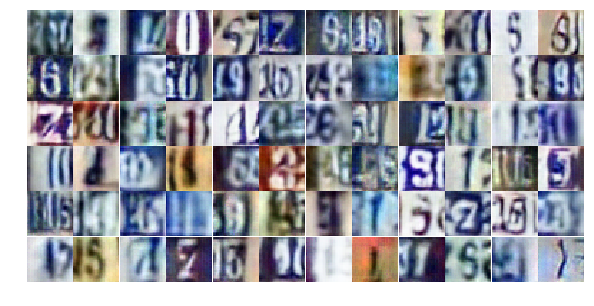

Epoch 14/30... Discriminator Loss: 1.1322... Generator Loss: 2.2889
Epoch 14/30... Discriminator Loss: 1.1122... Generator Loss: 0.5225
Epoch 14/30... Discriminator Loss: 0.5601... Generator Loss: 1.3870
Epoch 14/30... Discriminator Loss: 0.6566... Generator Loss: 1.0180
Epoch 14/30... Discriminator Loss: 1.1285... Generator Loss: 0.5366
Epoch 14/30... Discriminator Loss: 0.3362... Generator Loss: 1.6658
Epoch 14/30... Discriminator Loss: 0.4448... Generator Loss: 1.5391
Epoch 14/30... Discriminator Loss: 1.2464... Generator Loss: 0.4651
Epoch 14/30... Discriminator Loss: 1.2442... Generator Loss: 0.5189
Epoch 14/30... Discriminator Loss: 1.3928... Generator Loss: 0.4045


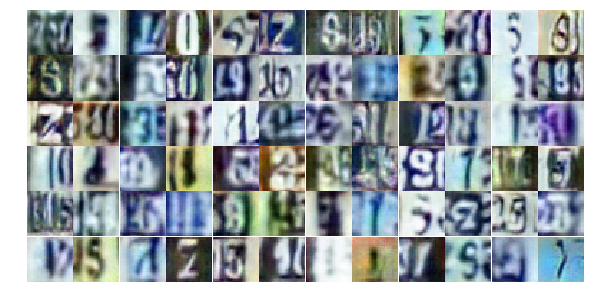

Epoch 14/30... Discriminator Loss: 0.5634... Generator Loss: 1.1496
Epoch 14/30... Discriminator Loss: 0.7944... Generator Loss: 3.4314
Epoch 14/30... Discriminator Loss: 2.7479... Generator Loss: 4.3053
Epoch 14/30... Discriminator Loss: 1.4503... Generator Loss: 1.2596
Epoch 14/30... Discriminator Loss: 0.9417... Generator Loss: 1.5011
Epoch 14/30... Discriminator Loss: 0.7933... Generator Loss: 1.2464
Epoch 14/30... Discriminator Loss: 0.6230... Generator Loss: 1.3983
Epoch 14/30... Discriminator Loss: 0.7457... Generator Loss: 1.0533
Epoch 14/30... Discriminator Loss: 0.6104... Generator Loss: 1.1735
Epoch 14/30... Discriminator Loss: 0.5061... Generator Loss: 1.3545


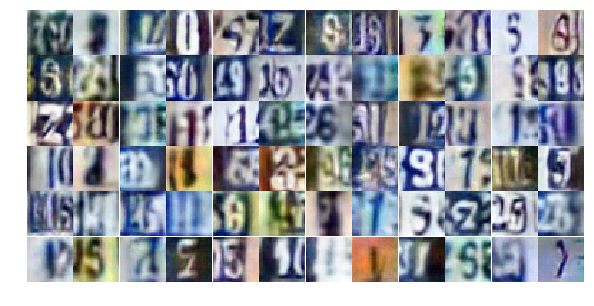

Epoch 14/30... Discriminator Loss: 1.0662... Generator Loss: 0.6051
Epoch 14/30... Discriminator Loss: 0.5762... Generator Loss: 1.1925
Epoch 14/30... Discriminator Loss: 0.5926... Generator Loss: 1.1234
Epoch 14/30... Discriminator Loss: 0.5052... Generator Loss: 1.3571
Epoch 14/30... Discriminator Loss: 0.5407... Generator Loss: 1.5108
Epoch 14/30... Discriminator Loss: 0.9021... Generator Loss: 0.8404
Epoch 14/30... Discriminator Loss: 0.8417... Generator Loss: 0.9324
Epoch 14/30... Discriminator Loss: 0.4646... Generator Loss: 1.5503
Epoch 14/30... Discriminator Loss: 0.4962... Generator Loss: 2.8184
Epoch 14/30... Discriminator Loss: 0.8797... Generator Loss: 0.8170


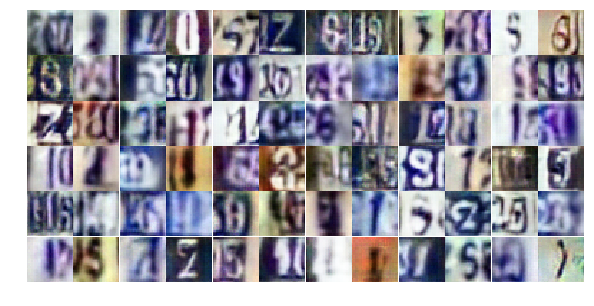

Epoch 14/30... Discriminator Loss: 1.2367... Generator Loss: 0.5194
Epoch 14/30... Discriminator Loss: 0.9689... Generator Loss: 0.6393
Epoch 14/30... Discriminator Loss: 0.8861... Generator Loss: 0.6982
Epoch 14/30... Discriminator Loss: 0.8218... Generator Loss: 0.8438
Epoch 14/30... Discriminator Loss: 0.9044... Generator Loss: 0.8510
Epoch 14/30... Discriminator Loss: 0.8604... Generator Loss: 0.8862
Epoch 14/30... Discriminator Loss: 0.6194... Generator Loss: 1.3944
Epoch 14/30... Discriminator Loss: 0.8363... Generator Loss: 0.9648
Epoch 14/30... Discriminator Loss: 1.5837... Generator Loss: 0.3791
Epoch 14/30... Discriminator Loss: 1.4305... Generator Loss: 0.3690


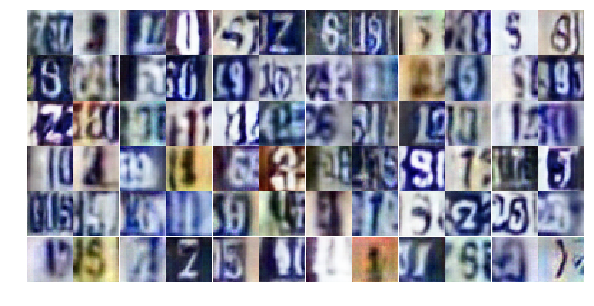

Epoch 14/30... Discriminator Loss: 0.9261... Generator Loss: 1.0153
Epoch 14/30... Discriminator Loss: 1.3219... Generator Loss: 0.4113
Epoch 14/30... Discriminator Loss: 0.5925... Generator Loss: 1.3745
Epoch 14/30... Discriminator Loss: 1.1185... Generator Loss: 0.5977
Epoch 14/30... Discriminator Loss: 0.6573... Generator Loss: 0.9973
Epoch 14/30... Discriminator Loss: 0.7512... Generator Loss: 0.9103
Epoch 14/30... Discriminator Loss: 0.8798... Generator Loss: 0.9656
Epoch 14/30... Discriminator Loss: 0.6815... Generator Loss: 1.0792
Epoch 14/30... Discriminator Loss: 0.9749... Generator Loss: 1.2380
Epoch 14/30... Discriminator Loss: 1.3468... Generator Loss: 0.4801


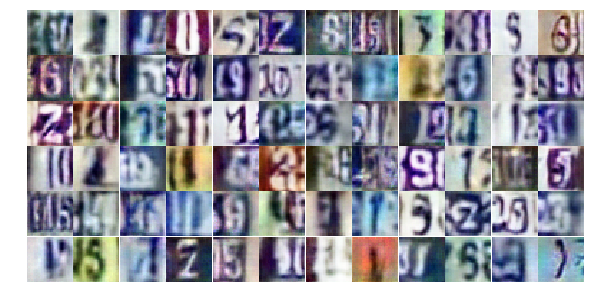

Epoch 14/30... Discriminator Loss: 0.8146... Generator Loss: 1.2083
Epoch 14/30... Discriminator Loss: 0.9222... Generator Loss: 0.7682
Epoch 15/30... Discriminator Loss: 0.7375... Generator Loss: 0.9601
Epoch 15/30... Discriminator Loss: 0.5516... Generator Loss: 1.8213
Epoch 15/30... Discriminator Loss: 0.6164... Generator Loss: 1.2309
Epoch 15/30... Discriminator Loss: 1.1605... Generator Loss: 0.5337
Epoch 15/30... Discriminator Loss: 1.1344... Generator Loss: 0.5873
Epoch 15/30... Discriminator Loss: 0.5525... Generator Loss: 1.2431
Epoch 15/30... Discriminator Loss: 1.5376... Generator Loss: 0.3441
Epoch 15/30... Discriminator Loss: 0.8682... Generator Loss: 0.8061


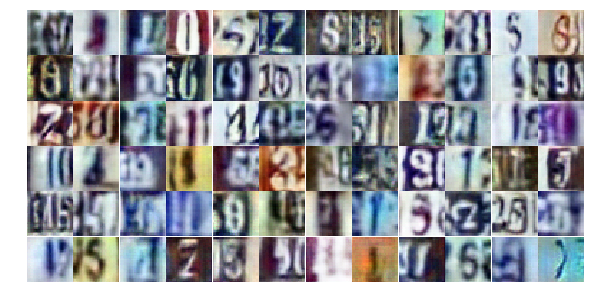

Epoch 15/30... Discriminator Loss: 0.7765... Generator Loss: 0.9690
Epoch 15/30... Discriminator Loss: 0.7902... Generator Loss: 1.4520
Epoch 15/30... Discriminator Loss: 1.0091... Generator Loss: 0.7168
Epoch 15/30... Discriminator Loss: 0.6439... Generator Loss: 1.1442
Epoch 15/30... Discriminator Loss: 0.9256... Generator Loss: 0.8199
Epoch 15/30... Discriminator Loss: 0.5509... Generator Loss: 1.3287
Epoch 15/30... Discriminator Loss: 1.1099... Generator Loss: 0.5287
Epoch 15/30... Discriminator Loss: 0.5679... Generator Loss: 1.5471
Epoch 15/30... Discriminator Loss: 0.6712... Generator Loss: 2.4858
Epoch 15/30... Discriminator Loss: 1.2958... Generator Loss: 0.5114


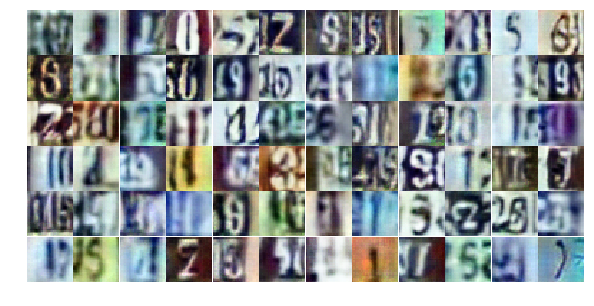

Epoch 15/30... Discriminator Loss: 0.7684... Generator Loss: 0.9422
Epoch 15/30... Discriminator Loss: 0.7799... Generator Loss: 0.9301
Epoch 15/30... Discriminator Loss: 0.5396... Generator Loss: 1.3323
Epoch 15/30... Discriminator Loss: 1.0018... Generator Loss: 0.6556
Epoch 15/30... Discriminator Loss: 1.2305... Generator Loss: 0.5160
Epoch 15/30... Discriminator Loss: 0.4874... Generator Loss: 1.4186
Epoch 15/30... Discriminator Loss: 1.0061... Generator Loss: 0.8050
Epoch 15/30... Discriminator Loss: 0.8930... Generator Loss: 0.8322
Epoch 15/30... Discriminator Loss: 0.6448... Generator Loss: 1.0202
Epoch 15/30... Discriminator Loss: 1.5393... Generator Loss: 0.3681


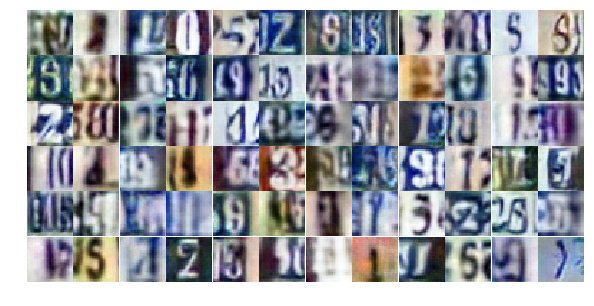

Epoch 15/30... Discriminator Loss: 0.6800... Generator Loss: 0.9831
Epoch 15/30... Discriminator Loss: 1.2038... Generator Loss: 0.5066
Epoch 15/30... Discriminator Loss: 0.4090... Generator Loss: 1.4928
Epoch 15/30... Discriminator Loss: 0.6413... Generator Loss: 1.1432
Epoch 15/30... Discriminator Loss: 0.6014... Generator Loss: 1.5154
Epoch 15/30... Discriminator Loss: 0.9811... Generator Loss: 2.4074
Epoch 15/30... Discriminator Loss: 0.5144... Generator Loss: 1.9085
Epoch 15/30... Discriminator Loss: 0.7038... Generator Loss: 1.2242
Epoch 15/30... Discriminator Loss: 0.6372... Generator Loss: 2.1466
Epoch 15/30... Discriminator Loss: 0.7672... Generator Loss: 0.9548


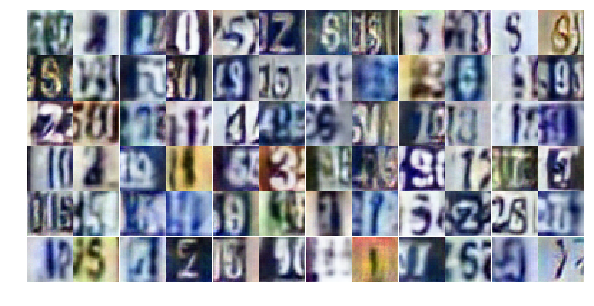

Epoch 15/30... Discriminator Loss: 0.7888... Generator Loss: 0.8238
Epoch 15/30... Discriminator Loss: 1.4144... Generator Loss: 0.4253
Epoch 15/30... Discriminator Loss: 0.8116... Generator Loss: 0.8970
Epoch 15/30... Discriminator Loss: 0.5467... Generator Loss: 1.4124
Epoch 15/30... Discriminator Loss: 1.1340... Generator Loss: 0.5546
Epoch 15/30... Discriminator Loss: 1.5817... Generator Loss: 0.3109
Epoch 15/30... Discriminator Loss: 0.5781... Generator Loss: 1.2954
Epoch 15/30... Discriminator Loss: 1.0012... Generator Loss: 1.4357
Epoch 15/30... Discriminator Loss: 0.7041... Generator Loss: 1.1130
Epoch 15/30... Discriminator Loss: 0.8008... Generator Loss: 0.8342


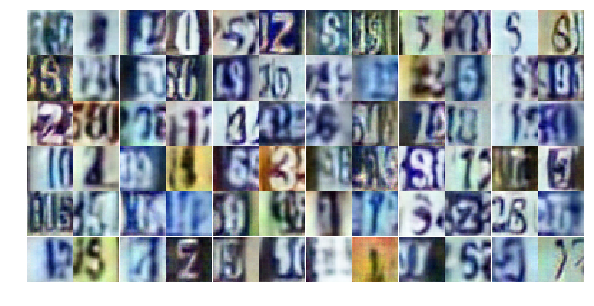

Epoch 15/30... Discriminator Loss: 1.2953... Generator Loss: 0.4241
Epoch 15/30... Discriminator Loss: 0.9917... Generator Loss: 0.6519
Epoch 15/30... Discriminator Loss: 0.7014... Generator Loss: 0.9614
Epoch 15/30... Discriminator Loss: 0.9301... Generator Loss: 0.8107
Epoch 15/30... Discriminator Loss: 0.5845... Generator Loss: 1.3122
Epoch 15/30... Discriminator Loss: 0.6731... Generator Loss: 1.7320
Epoch 15/30... Discriminator Loss: 1.3133... Generator Loss: 0.4861
Epoch 15/30... Discriminator Loss: 0.4287... Generator Loss: 1.8343
Epoch 15/30... Discriminator Loss: 1.3652... Generator Loss: 0.4346
Epoch 16/30... Discriminator Loss: 1.2431... Generator Loss: 0.4772


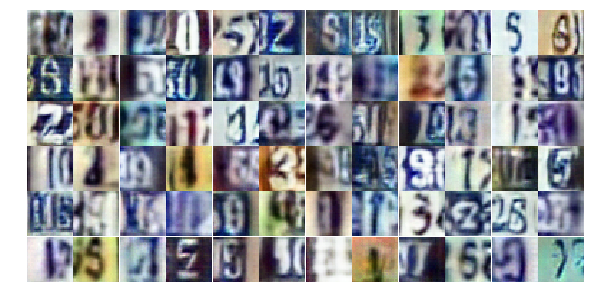

Epoch 16/30... Discriminator Loss: 0.8373... Generator Loss: 0.9018
Epoch 16/30... Discriminator Loss: 0.7026... Generator Loss: 1.0155
Epoch 16/30... Discriminator Loss: 0.8934... Generator Loss: 0.7228
Epoch 16/30... Discriminator Loss: 0.6952... Generator Loss: 1.8696
Epoch 16/30... Discriminator Loss: 0.6459... Generator Loss: 1.3107
Epoch 16/30... Discriminator Loss: 0.6701... Generator Loss: 1.4014
Epoch 16/30... Discriminator Loss: 1.6254... Generator Loss: 0.3232
Epoch 16/30... Discriminator Loss: 1.2505... Generator Loss: 0.4672
Epoch 16/30... Discriminator Loss: 0.7543... Generator Loss: 0.8866
Epoch 16/30... Discriminator Loss: 0.5908... Generator Loss: 1.5631


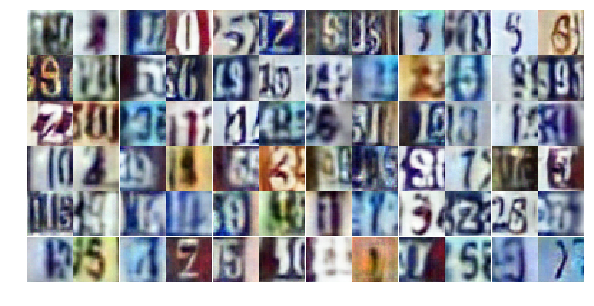

Epoch 16/30... Discriminator Loss: 1.6526... Generator Loss: 0.3521
Epoch 16/30... Discriminator Loss: 0.8512... Generator Loss: 0.8543
Epoch 16/30... Discriminator Loss: 1.0731... Generator Loss: 0.6386
Epoch 16/30... Discriminator Loss: 1.4808... Generator Loss: 0.3743
Epoch 16/30... Discriminator Loss: 0.4681... Generator Loss: 2.0484
Epoch 16/30... Discriminator Loss: 0.8438... Generator Loss: 0.7863
Epoch 16/30... Discriminator Loss: 0.8556... Generator Loss: 0.9554
Epoch 16/30... Discriminator Loss: 0.4355... Generator Loss: 1.6248
Epoch 16/30... Discriminator Loss: 0.4415... Generator Loss: 1.5640
Epoch 16/30... Discriminator Loss: 0.5746... Generator Loss: 1.1829


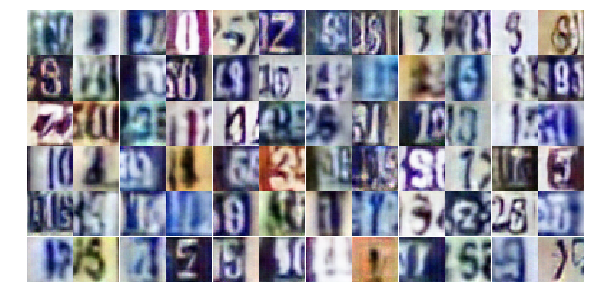

Epoch 16/30... Discriminator Loss: 0.8594... Generator Loss: 0.7882
Epoch 16/30... Discriminator Loss: 0.6422... Generator Loss: 1.6429
Epoch 16/30... Discriminator Loss: 1.0501... Generator Loss: 0.6544
Epoch 16/30... Discriminator Loss: 0.9281... Generator Loss: 0.6808
Epoch 16/30... Discriminator Loss: 0.8099... Generator Loss: 0.8090
Epoch 16/30... Discriminator Loss: 1.2426... Generator Loss: 0.5491
Epoch 16/30... Discriminator Loss: 0.7644... Generator Loss: 1.0295
Epoch 16/30... Discriminator Loss: 0.5202... Generator Loss: 1.2895
Epoch 16/30... Discriminator Loss: 0.7602... Generator Loss: 0.9063
Epoch 16/30... Discriminator Loss: 0.7173... Generator Loss: 1.0829


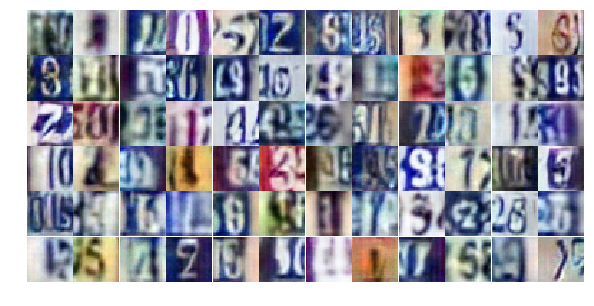

Epoch 16/30... Discriminator Loss: 0.7377... Generator Loss: 0.8829
Epoch 16/30... Discriminator Loss: 0.7123... Generator Loss: 1.0509
Epoch 16/30... Discriminator Loss: 0.6575... Generator Loss: 1.4101
Epoch 16/30... Discriminator Loss: 0.5790... Generator Loss: 1.2849
Epoch 16/30... Discriminator Loss: 0.9050... Generator Loss: 0.7622
Epoch 16/30... Discriminator Loss: 0.7678... Generator Loss: 1.8210
Epoch 16/30... Discriminator Loss: 1.0215... Generator Loss: 0.6017
Epoch 16/30... Discriminator Loss: 1.6780... Generator Loss: 0.3036
Epoch 16/30... Discriminator Loss: 1.0839... Generator Loss: 0.5688
Epoch 16/30... Discriminator Loss: 0.5716... Generator Loss: 1.2616


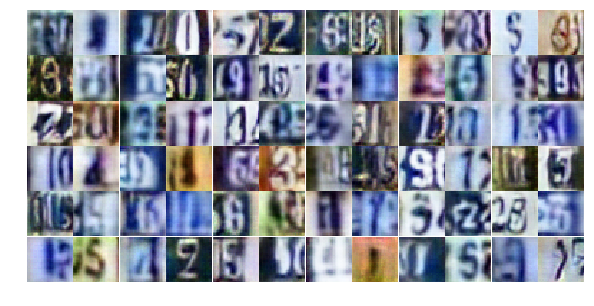

Epoch 16/30... Discriminator Loss: 0.6539... Generator Loss: 1.1776
Epoch 16/30... Discriminator Loss: 0.5723... Generator Loss: 1.5198
Epoch 16/30... Discriminator Loss: 1.0696... Generator Loss: 0.6169
Epoch 16/30... Discriminator Loss: 1.2501... Generator Loss: 3.7381
Epoch 16/30... Discriminator Loss: 2.3045... Generator Loss: 0.1828
Epoch 16/30... Discriminator Loss: 1.2005... Generator Loss: 0.5554
Epoch 16/30... Discriminator Loss: 0.6869... Generator Loss: 1.8224
Epoch 16/30... Discriminator Loss: 0.8338... Generator Loss: 0.9548
Epoch 16/30... Discriminator Loss: 0.6434... Generator Loss: 1.0102
Epoch 16/30... Discriminator Loss: 1.1728... Generator Loss: 0.5733


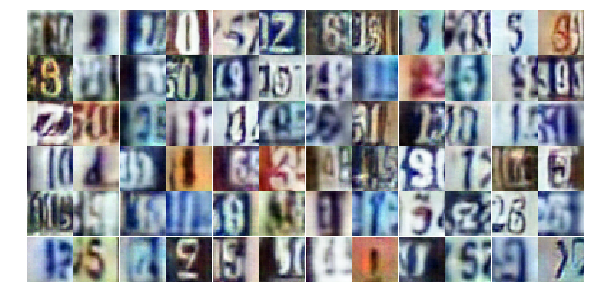

Epoch 16/30... Discriminator Loss: 1.3584... Generator Loss: 0.4343
Epoch 16/30... Discriminator Loss: 0.8483... Generator Loss: 0.8358
Epoch 16/30... Discriminator Loss: 1.4139... Generator Loss: 0.4482
Epoch 16/30... Discriminator Loss: 0.6338... Generator Loss: 1.1741
Epoch 16/30... Discriminator Loss: 0.9378... Generator Loss: 0.7540
Epoch 16/30... Discriminator Loss: 0.6288... Generator Loss: 1.1473
Epoch 17/30... Discriminator Loss: 0.7846... Generator Loss: 0.9458
Epoch 17/30... Discriminator Loss: 0.7021... Generator Loss: 1.1455
Epoch 17/30... Discriminator Loss: 0.7510... Generator Loss: 0.9695
Epoch 17/30... Discriminator Loss: 0.7712... Generator Loss: 1.0406


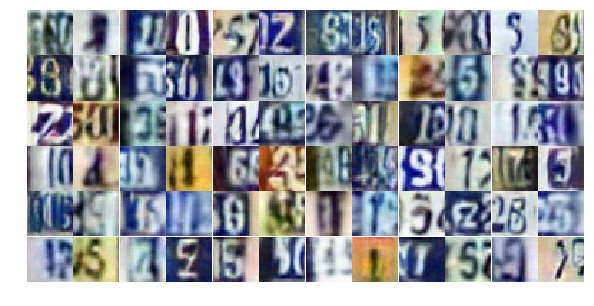

Epoch 17/30... Discriminator Loss: 0.5223... Generator Loss: 1.7411
Epoch 17/30... Discriminator Loss: 0.4874... Generator Loss: 1.3771
Epoch 17/30... Discriminator Loss: 1.1760... Generator Loss: 0.5749
Epoch 17/30... Discriminator Loss: 0.8497... Generator Loss: 0.7685
Epoch 17/30... Discriminator Loss: 0.8300... Generator Loss: 0.8552
Epoch 17/30... Discriminator Loss: 1.0873... Generator Loss: 0.5719
Epoch 17/30... Discriminator Loss: 0.7271... Generator Loss: 1.2432
Epoch 17/30... Discriminator Loss: 0.4678... Generator Loss: 1.3652
Epoch 17/30... Discriminator Loss: 0.4006... Generator Loss: 1.6363
Epoch 17/30... Discriminator Loss: 0.5873... Generator Loss: 1.5537


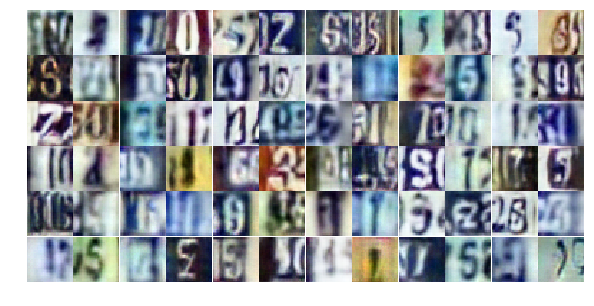

Epoch 17/30... Discriminator Loss: 1.1096... Generator Loss: 0.5772
Epoch 17/30... Discriminator Loss: 0.7066... Generator Loss: 1.1798
Epoch 17/30... Discriminator Loss: 0.7805... Generator Loss: 0.9592
Epoch 17/30... Discriminator Loss: 0.5567... Generator Loss: 1.4941
Epoch 17/30... Discriminator Loss: 0.4656... Generator Loss: 1.5608
Epoch 17/30... Discriminator Loss: 1.1061... Generator Loss: 0.5969
Epoch 17/30... Discriminator Loss: 0.5231... Generator Loss: 1.5182
Epoch 17/30... Discriminator Loss: 0.9896... Generator Loss: 0.6774
Epoch 17/30... Discriminator Loss: 0.5678... Generator Loss: 1.1517
Epoch 17/30... Discriminator Loss: 0.7165... Generator Loss: 0.9667


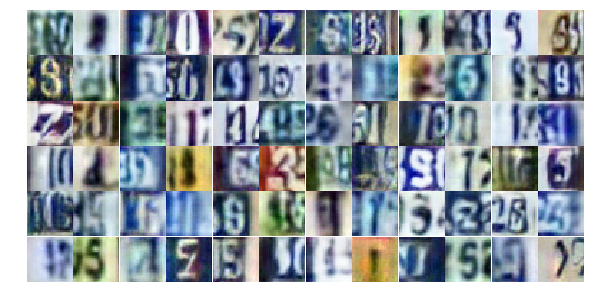

Epoch 17/30... Discriminator Loss: 1.9881... Generator Loss: 0.2158
Epoch 17/30... Discriminator Loss: 0.7594... Generator Loss: 1.0012
Epoch 17/30... Discriminator Loss: 0.6496... Generator Loss: 1.5757
Epoch 17/30... Discriminator Loss: 1.6926... Generator Loss: 0.2851
Epoch 17/30... Discriminator Loss: 1.1893... Generator Loss: 0.5318
Epoch 17/30... Discriminator Loss: 0.5405... Generator Loss: 1.2213
Epoch 17/30... Discriminator Loss: 0.5167... Generator Loss: 1.3822
Epoch 17/30... Discriminator Loss: 1.1022... Generator Loss: 0.5584
Epoch 17/30... Discriminator Loss: 1.0688... Generator Loss: 0.5764
Epoch 17/30... Discriminator Loss: 0.4497... Generator Loss: 1.5434


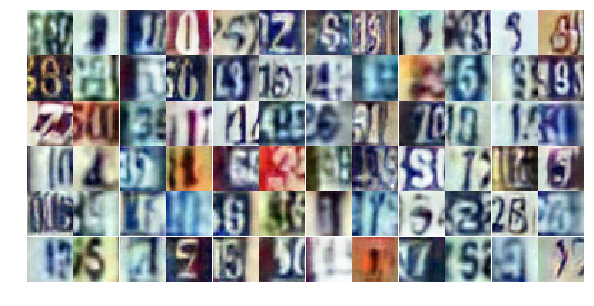

Epoch 17/30... Discriminator Loss: 0.7177... Generator Loss: 1.4530
Epoch 17/30... Discriminator Loss: 1.8396... Generator Loss: 0.7810
Epoch 17/30... Discriminator Loss: 0.7766... Generator Loss: 0.9716
Epoch 17/30... Discriminator Loss: 0.8640... Generator Loss: 0.7806
Epoch 17/30... Discriminator Loss: 0.8390... Generator Loss: 0.8915
Epoch 17/30... Discriminator Loss: 0.5825... Generator Loss: 1.1714
Epoch 17/30... Discriminator Loss: 0.8964... Generator Loss: 0.7162
Epoch 17/30... Discriminator Loss: 0.4959... Generator Loss: 1.6350
Epoch 17/30... Discriminator Loss: 0.2634... Generator Loss: 2.3243
Epoch 17/30... Discriminator Loss: 1.0496... Generator Loss: 0.5859


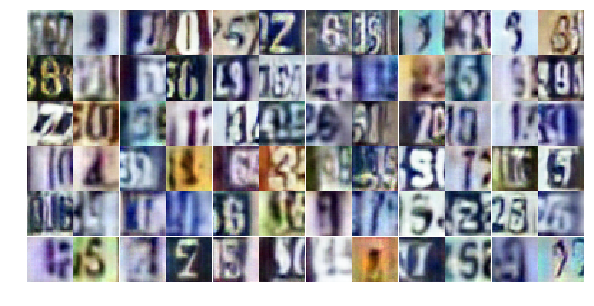

Epoch 17/30... Discriminator Loss: 3.2834... Generator Loss: 0.2694
Epoch 17/30... Discriminator Loss: 0.6427... Generator Loss: 1.7415
Epoch 17/30... Discriminator Loss: 0.6951... Generator Loss: 1.3428
Epoch 17/30... Discriminator Loss: 0.5257... Generator Loss: 1.7708
Epoch 17/30... Discriminator Loss: 0.8539... Generator Loss: 0.9199
Epoch 17/30... Discriminator Loss: 0.8690... Generator Loss: 0.7915
Epoch 17/30... Discriminator Loss: 0.9936... Generator Loss: 0.7039
Epoch 17/30... Discriminator Loss: 0.8083... Generator Loss: 0.9078
Epoch 17/30... Discriminator Loss: 0.6723... Generator Loss: 1.1925
Epoch 17/30... Discriminator Loss: 1.1296... Generator Loss: 0.6134


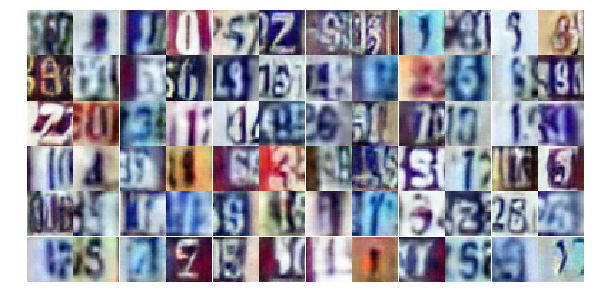

Epoch 17/30... Discriminator Loss: 0.6407... Generator Loss: 1.4545
Epoch 17/30... Discriminator Loss: 0.8006... Generator Loss: 1.5572
Epoch 17/30... Discriminator Loss: 0.7675... Generator Loss: 0.9186
Epoch 17/30... Discriminator Loss: 0.6832... Generator Loss: 1.9009
Epoch 18/30... Discriminator Loss: 0.6268... Generator Loss: 1.3378
Epoch 18/30... Discriminator Loss: 1.0299... Generator Loss: 0.6072
Epoch 18/30... Discriminator Loss: 0.7578... Generator Loss: 0.9682
Epoch 18/30... Discriminator Loss: 0.5318... Generator Loss: 1.1913
Epoch 18/30... Discriminator Loss: 1.1105... Generator Loss: 0.5700
Epoch 18/30... Discriminator Loss: 0.8632... Generator Loss: 0.7775


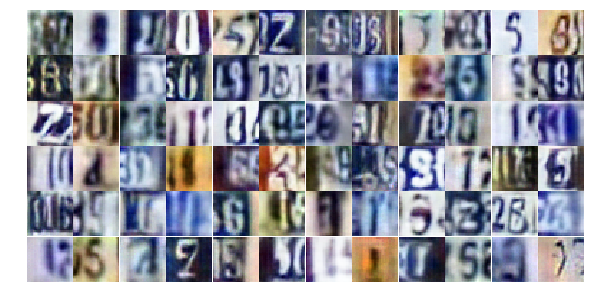

Epoch 18/30... Discriminator Loss: 0.5351... Generator Loss: 1.4731
Epoch 18/30... Discriminator Loss: 0.9284... Generator Loss: 0.7529
Epoch 18/30... Discriminator Loss: 0.9658... Generator Loss: 0.6605
Epoch 18/30... Discriminator Loss: 0.5163... Generator Loss: 1.7405
Epoch 18/30... Discriminator Loss: 0.5332... Generator Loss: 1.2156
Epoch 18/30... Discriminator Loss: 0.7420... Generator Loss: 1.1472
Epoch 18/30... Discriminator Loss: 0.6231... Generator Loss: 1.0705
Epoch 18/30... Discriminator Loss: 1.0484... Generator Loss: 0.5894
Epoch 18/30... Discriminator Loss: 0.6990... Generator Loss: 1.0216
Epoch 18/30... Discriminator Loss: 0.3400... Generator Loss: 1.9838


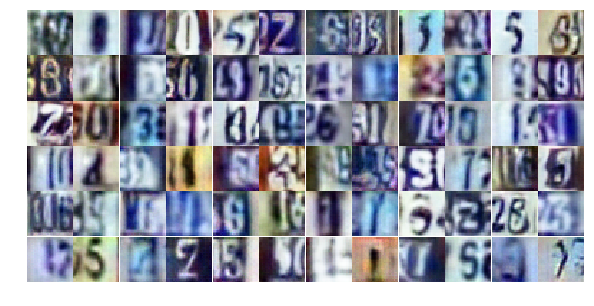

Epoch 18/30... Discriminator Loss: 0.7796... Generator Loss: 0.9416
Epoch 18/30... Discriminator Loss: 0.6141... Generator Loss: 1.4052
Epoch 18/30... Discriminator Loss: 0.9498... Generator Loss: 0.7950
Epoch 18/30... Discriminator Loss: 0.4364... Generator Loss: 1.4354
Epoch 18/30... Discriminator Loss: 0.6846... Generator Loss: 1.0671
Epoch 18/30... Discriminator Loss: 1.0771... Generator Loss: 0.5514
Epoch 18/30... Discriminator Loss: 1.3734... Generator Loss: 0.4761
Epoch 18/30... Discriminator Loss: 1.1248... Generator Loss: 0.5946
Epoch 18/30... Discriminator Loss: 0.7606... Generator Loss: 0.9156
Epoch 18/30... Discriminator Loss: 0.5432... Generator Loss: 1.1663


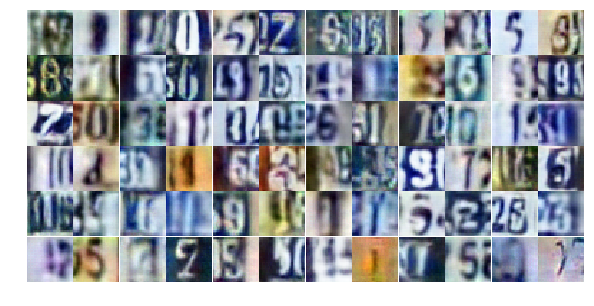

Epoch 18/30... Discriminator Loss: 0.5786... Generator Loss: 1.3414
Epoch 18/30... Discriminator Loss: 0.7888... Generator Loss: 1.1027
Epoch 18/30... Discriminator Loss: 0.7349... Generator Loss: 0.9871
Epoch 18/30... Discriminator Loss: 0.8749... Generator Loss: 0.7715
Epoch 18/30... Discriminator Loss: 0.8728... Generator Loss: 0.7730
Epoch 18/30... Discriminator Loss: 0.8188... Generator Loss: 0.8624
Epoch 18/30... Discriminator Loss: 0.7771... Generator Loss: 0.9492
Epoch 18/30... Discriminator Loss: 0.5634... Generator Loss: 1.2475
Epoch 18/30... Discriminator Loss: 0.6512... Generator Loss: 1.0961
Epoch 18/30... Discriminator Loss: 0.7277... Generator Loss: 1.2210


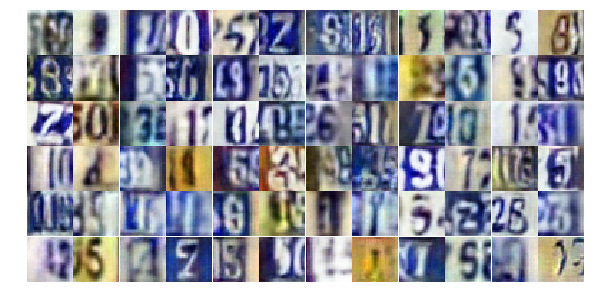

Epoch 18/30... Discriminator Loss: 0.4738... Generator Loss: 1.6311
Epoch 18/30... Discriminator Loss: 0.6944... Generator Loss: 1.0794
Epoch 18/30... Discriminator Loss: 0.7775... Generator Loss: 0.9272
Epoch 18/30... Discriminator Loss: 0.9420... Generator Loss: 0.6622
Epoch 18/30... Discriminator Loss: 0.8089... Generator Loss: 0.8869
Epoch 18/30... Discriminator Loss: 0.4487... Generator Loss: 1.4622
Epoch 18/30... Discriminator Loss: 1.0847... Generator Loss: 0.5647
Epoch 18/30... Discriminator Loss: 1.2182... Generator Loss: 2.0786
Epoch 18/30... Discriminator Loss: 0.5559... Generator Loss: 1.4805
Epoch 18/30... Discriminator Loss: 0.4990... Generator Loss: 1.2646


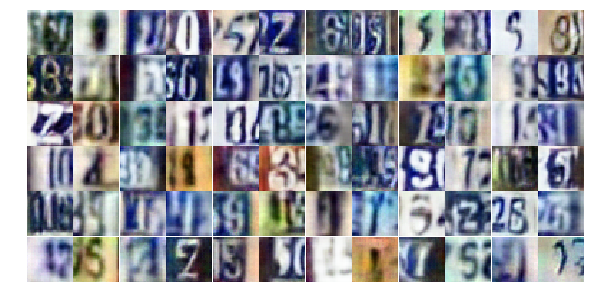

Epoch 18/30... Discriminator Loss: 0.6686... Generator Loss: 1.0524
Epoch 18/30... Discriminator Loss: 0.7069... Generator Loss: 0.9929
Epoch 18/30... Discriminator Loss: 0.7269... Generator Loss: 1.0138
Epoch 18/30... Discriminator Loss: 1.1866... Generator Loss: 0.4926
Epoch 18/30... Discriminator Loss: 0.5280... Generator Loss: 1.3875
Epoch 18/30... Discriminator Loss: 0.5496... Generator Loss: 1.2254
Epoch 18/30... Discriminator Loss: 0.7049... Generator Loss: 0.9388
Epoch 18/30... Discriminator Loss: 0.5551... Generator Loss: 1.3409
Epoch 18/30... Discriminator Loss: 1.1631... Generator Loss: 0.5881
Epoch 18/30... Discriminator Loss: 1.6065... Generator Loss: 0.3614


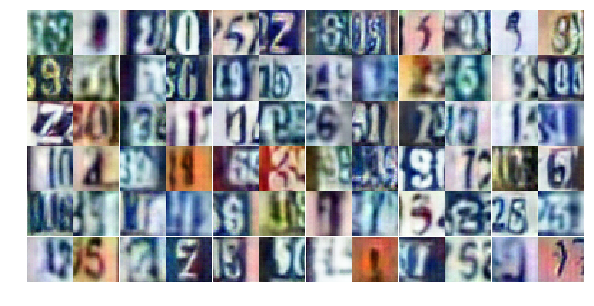

Epoch 18/30... Discriminator Loss: 0.5387... Generator Loss: 1.8646
Epoch 19/30... Discriminator Loss: 1.0438... Generator Loss: 0.7072
Epoch 19/30... Discriminator Loss: 1.2182... Generator Loss: 0.5456
Epoch 19/30... Discriminator Loss: 0.7257... Generator Loss: 1.1530
Epoch 19/30... Discriminator Loss: 0.8646... Generator Loss: 0.7363
Epoch 19/30... Discriminator Loss: 1.1064... Generator Loss: 0.5936
Epoch 19/30... Discriminator Loss: 0.7122... Generator Loss: 1.0025
Epoch 19/30... Discriminator Loss: 0.6959... Generator Loss: 1.0607
Epoch 19/30... Discriminator Loss: 0.6080... Generator Loss: 1.6588
Epoch 19/30... Discriminator Loss: 0.8658... Generator Loss: 1.0729


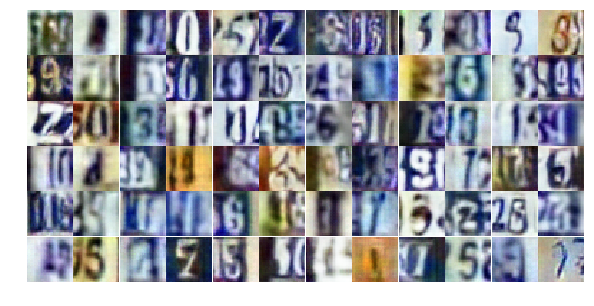

Epoch 19/30... Discriminator Loss: 0.8408... Generator Loss: 0.7777
Epoch 19/30... Discriminator Loss: 0.8190... Generator Loss: 0.9266
Epoch 19/30... Discriminator Loss: 0.7429... Generator Loss: 1.0760
Epoch 19/30... Discriminator Loss: 1.3408... Generator Loss: 0.4246
Epoch 19/30... Discriminator Loss: 1.1734... Generator Loss: 0.6959
Epoch 19/30... Discriminator Loss: 0.9319... Generator Loss: 2.7451
Epoch 19/30... Discriminator Loss: 0.7648... Generator Loss: 1.0127
Epoch 19/30... Discriminator Loss: 0.7647... Generator Loss: 0.8821
Epoch 19/30... Discriminator Loss: 0.9112... Generator Loss: 0.7499
Epoch 19/30... Discriminator Loss: 1.0156... Generator Loss: 0.7121


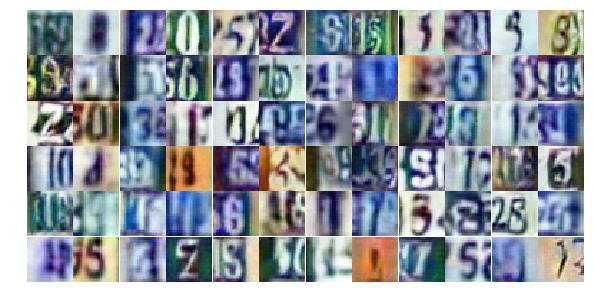

Epoch 19/30... Discriminator Loss: 0.8432... Generator Loss: 0.7667
Epoch 19/30... Discriminator Loss: 1.5095... Generator Loss: 0.3394
Epoch 19/30... Discriminator Loss: 1.2595... Generator Loss: 0.5058
Epoch 19/30... Discriminator Loss: 1.2786... Generator Loss: 0.5169
Epoch 19/30... Discriminator Loss: 1.4017... Generator Loss: 0.4136
Epoch 19/30... Discriminator Loss: 0.6645... Generator Loss: 1.1785
Epoch 19/30... Discriminator Loss: 0.9360... Generator Loss: 0.7069
Epoch 19/30... Discriminator Loss: 0.5228... Generator Loss: 1.2158
Epoch 19/30... Discriminator Loss: 0.7419... Generator Loss: 0.9290
Epoch 19/30... Discriminator Loss: 0.9955... Generator Loss: 0.6412


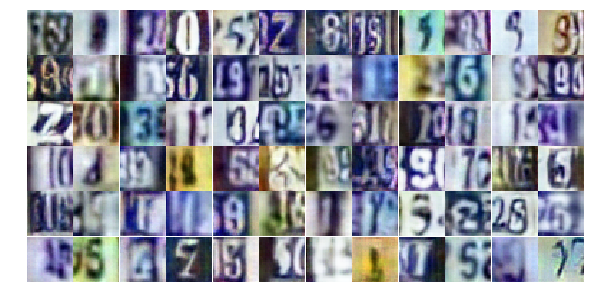

Epoch 19/30... Discriminator Loss: 0.7811... Generator Loss: 1.0439
Epoch 19/30... Discriminator Loss: 0.7398... Generator Loss: 0.8748
Epoch 19/30... Discriminator Loss: 0.6746... Generator Loss: 1.0684
Epoch 19/30... Discriminator Loss: 0.5595... Generator Loss: 1.2356
Epoch 19/30... Discriminator Loss: 1.7325... Generator Loss: 0.2695
Epoch 19/30... Discriminator Loss: 1.4126... Generator Loss: 0.4396
Epoch 19/30... Discriminator Loss: 0.6880... Generator Loss: 1.0810
Epoch 19/30... Discriminator Loss: 0.5289... Generator Loss: 1.2412
Epoch 19/30... Discriminator Loss: 0.9181... Generator Loss: 0.7667
Epoch 19/30... Discriminator Loss: 0.4071... Generator Loss: 1.5777


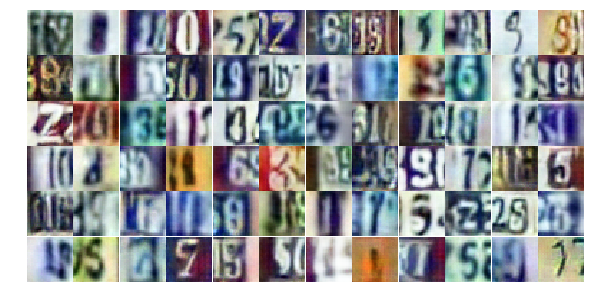

Epoch 19/30... Discriminator Loss: 0.6040... Generator Loss: 1.3507
Epoch 19/30... Discriminator Loss: 1.5700... Generator Loss: 0.3529
Epoch 19/30... Discriminator Loss: 1.7170... Generator Loss: 0.2868
Epoch 19/30... Discriminator Loss: 0.5447... Generator Loss: 1.2484
Epoch 19/30... Discriminator Loss: 1.3874... Generator Loss: 0.5217
Epoch 19/30... Discriminator Loss: 0.5511... Generator Loss: 1.6632
Epoch 19/30... Discriminator Loss: 0.6502... Generator Loss: 1.0903
Epoch 19/30... Discriminator Loss: 0.4408... Generator Loss: 1.5540
Epoch 19/30... Discriminator Loss: 0.8636... Generator Loss: 0.8741
Epoch 19/30... Discriminator Loss: 0.7465... Generator Loss: 0.9885


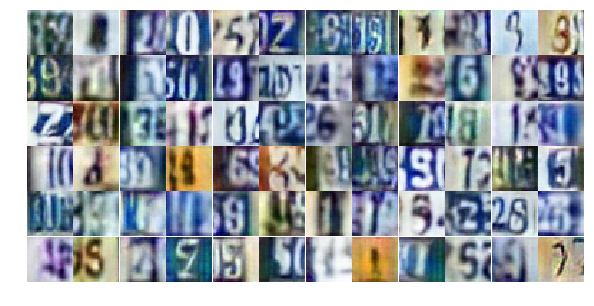

Epoch 19/30... Discriminator Loss: 1.0826... Generator Loss: 0.5430
Epoch 19/30... Discriminator Loss: 0.7095... Generator Loss: 1.0524
Epoch 19/30... Discriminator Loss: 0.6166... Generator Loss: 1.4996
Epoch 19/30... Discriminator Loss: 0.8582... Generator Loss: 0.8487
Epoch 19/30... Discriminator Loss: 0.6905... Generator Loss: 1.8218
Epoch 19/30... Discriminator Loss: 0.7904... Generator Loss: 1.2742
Epoch 19/30... Discriminator Loss: 1.8730... Generator Loss: 0.3194
Epoch 19/30... Discriminator Loss: 0.5700... Generator Loss: 1.3453
Epoch 20/30... Discriminator Loss: 0.7676... Generator Loss: 0.8819
Epoch 20/30... Discriminator Loss: 0.7362... Generator Loss: 0.9751


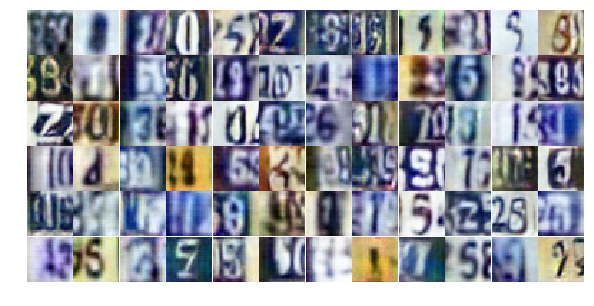

Epoch 20/30... Discriminator Loss: 0.5527... Generator Loss: 1.5347
Epoch 20/30... Discriminator Loss: 1.1376... Generator Loss: 0.5843
Epoch 20/30... Discriminator Loss: 0.9984... Generator Loss: 0.6390
Epoch 20/30... Discriminator Loss: 1.4946... Generator Loss: 0.4001
Epoch 20/30... Discriminator Loss: 0.6502... Generator Loss: 1.1146
Epoch 20/30... Discriminator Loss: 0.6149... Generator Loss: 1.3149
Epoch 20/30... Discriminator Loss: 0.7219... Generator Loss: 0.9893
Epoch 20/30... Discriminator Loss: 0.6248... Generator Loss: 1.3771
Epoch 20/30... Discriminator Loss: 1.1198... Generator Loss: 0.6240
Epoch 20/30... Discriminator Loss: 0.6156... Generator Loss: 1.0526


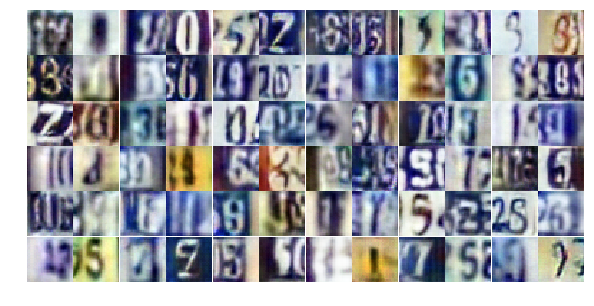

Epoch 20/30... Discriminator Loss: 1.1580... Generator Loss: 0.6617
Epoch 20/30... Discriminator Loss: 0.8435... Generator Loss: 0.8800
Epoch 20/30... Discriminator Loss: 0.7734... Generator Loss: 0.8678
Epoch 20/30... Discriminator Loss: 1.2678... Generator Loss: 0.5568
Epoch 20/30... Discriminator Loss: 0.9491... Generator Loss: 0.7260
Epoch 20/30... Discriminator Loss: 1.3056... Generator Loss: 1.6063
Epoch 20/30... Discriminator Loss: 1.0530... Generator Loss: 0.7740
Epoch 20/30... Discriminator Loss: 0.5488... Generator Loss: 2.3191
Epoch 20/30... Discriminator Loss: 0.6269... Generator Loss: 1.0808
Epoch 20/30... Discriminator Loss: 1.2735... Generator Loss: 0.4899


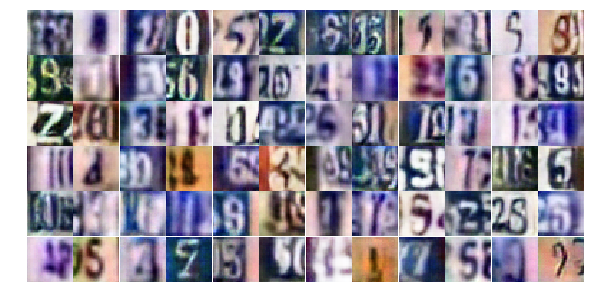

Epoch 20/30... Discriminator Loss: 0.7713... Generator Loss: 0.9660
Epoch 20/30... Discriminator Loss: 1.0980... Generator Loss: 0.6286
Epoch 20/30... Discriminator Loss: 0.4040... Generator Loss: 1.7654
Epoch 20/30... Discriminator Loss: 1.3708... Generator Loss: 0.4573
Epoch 20/30... Discriminator Loss: 1.0808... Generator Loss: 0.6305
Epoch 20/30... Discriminator Loss: 0.4996... Generator Loss: 1.4413
Epoch 20/30... Discriminator Loss: 0.5608... Generator Loss: 1.9124
Epoch 20/30... Discriminator Loss: 1.6888... Generator Loss: 0.3310
Epoch 20/30... Discriminator Loss: 1.1498... Generator Loss: 0.5247
Epoch 20/30... Discriminator Loss: 0.6063... Generator Loss: 1.0430


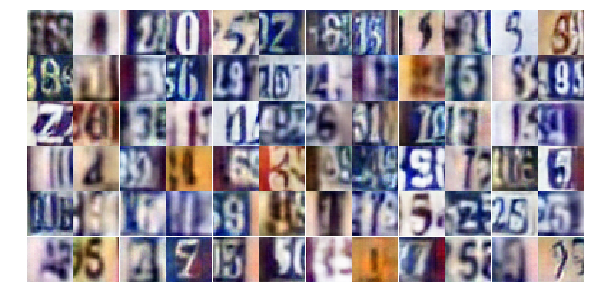

Epoch 20/30... Discriminator Loss: 0.6826... Generator Loss: 1.0986
Epoch 20/30... Discriminator Loss: 0.6928... Generator Loss: 1.0074
Epoch 20/30... Discriminator Loss: 0.8064... Generator Loss: 1.0867
Epoch 20/30... Discriminator Loss: 0.6653... Generator Loss: 1.7117
Epoch 20/30... Discriminator Loss: 0.6348... Generator Loss: 1.3404
Epoch 20/30... Discriminator Loss: 0.7107... Generator Loss: 0.9383
Epoch 20/30... Discriminator Loss: 0.9070... Generator Loss: 0.7571
Epoch 20/30... Discriminator Loss: 0.7176... Generator Loss: 0.9276
Epoch 20/30... Discriminator Loss: 0.7015... Generator Loss: 1.0877
Epoch 20/30... Discriminator Loss: 1.2080... Generator Loss: 0.5421


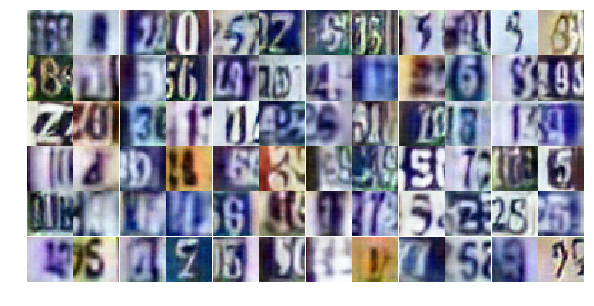

Epoch 20/30... Discriminator Loss: 1.4788... Generator Loss: 0.3695
Epoch 20/30... Discriminator Loss: 0.7091... Generator Loss: 1.2328
Epoch 20/30... Discriminator Loss: 3.0286... Generator Loss: 0.1128
Epoch 20/30... Discriminator Loss: 1.4002... Generator Loss: 0.5707
Epoch 20/30... Discriminator Loss: 1.7912... Generator Loss: 0.2673
Epoch 20/30... Discriminator Loss: 0.9060... Generator Loss: 0.8782
Epoch 20/30... Discriminator Loss: 0.9726... Generator Loss: 0.7159
Epoch 20/30... Discriminator Loss: 0.5882... Generator Loss: 1.7147
Epoch 20/30... Discriminator Loss: 0.5112... Generator Loss: 1.6800
Epoch 20/30... Discriminator Loss: 0.8103... Generator Loss: 0.9324


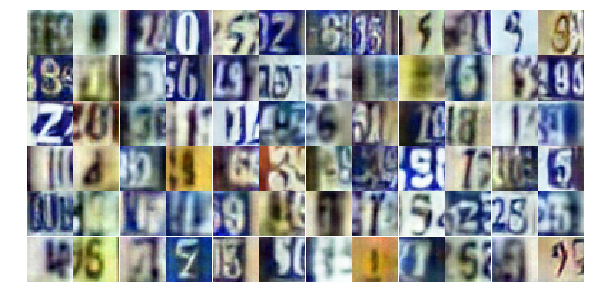

Epoch 20/30... Discriminator Loss: 0.7876... Generator Loss: 0.9364
Epoch 20/30... Discriminator Loss: 0.8456... Generator Loss: 0.9333
Epoch 20/30... Discriminator Loss: 0.4428... Generator Loss: 1.7688
Epoch 20/30... Discriminator Loss: 0.8249... Generator Loss: 1.3300
Epoch 20/30... Discriminator Loss: 0.6825... Generator Loss: 1.0082
Epoch 20/30... Discriminator Loss: 0.4795... Generator Loss: 1.3860
Epoch 21/30... Discriminator Loss: 0.7371... Generator Loss: 1.0877
Epoch 21/30... Discriminator Loss: 0.7322... Generator Loss: 1.0419
Epoch 21/30... Discriminator Loss: 1.6278... Generator Loss: 0.3175
Epoch 21/30... Discriminator Loss: 1.2031... Generator Loss: 0.5115


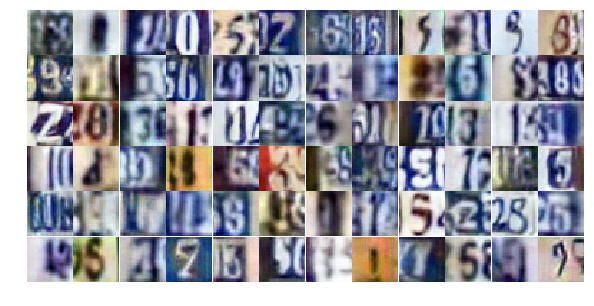

Epoch 21/30... Discriminator Loss: 0.5871... Generator Loss: 1.7279
Epoch 21/30... Discriminator Loss: 1.2165... Generator Loss: 0.4866
Epoch 21/30... Discriminator Loss: 0.4942... Generator Loss: 1.4455
Epoch 21/30... Discriminator Loss: 0.4582... Generator Loss: 1.7590
Epoch 21/30... Discriminator Loss: 0.7930... Generator Loss: 0.8571
Epoch 21/30... Discriminator Loss: 0.4392... Generator Loss: 1.5396
Epoch 21/30... Discriminator Loss: 1.3477... Generator Loss: 0.4103
Epoch 21/30... Discriminator Loss: 0.6665... Generator Loss: 1.1692
Epoch 21/30... Discriminator Loss: 0.7986... Generator Loss: 0.8012
Epoch 21/30... Discriminator Loss: 1.2344... Generator Loss: 0.4714


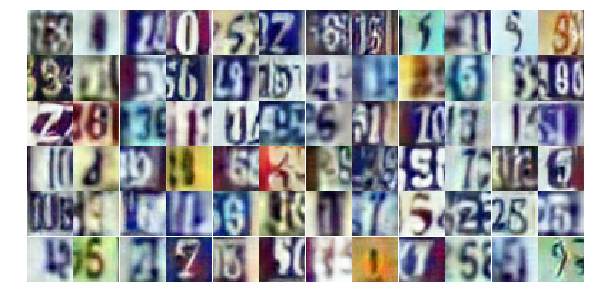

Epoch 21/30... Discriminator Loss: 0.3903... Generator Loss: 1.6802
Epoch 21/30... Discriminator Loss: 0.6659... Generator Loss: 1.0258
Epoch 21/30... Discriminator Loss: 1.1680... Generator Loss: 1.2868
Epoch 21/30... Discriminator Loss: 1.0338... Generator Loss: 0.7369
Epoch 21/30... Discriminator Loss: 0.6773... Generator Loss: 1.0537
Epoch 21/30... Discriminator Loss: 1.3167... Generator Loss: 0.4808
Epoch 21/30... Discriminator Loss: 1.0918... Generator Loss: 0.6300
Epoch 21/30... Discriminator Loss: 0.4420... Generator Loss: 1.6823
Epoch 21/30... Discriminator Loss: 0.4978... Generator Loss: 1.4667
Epoch 21/30... Discriminator Loss: 0.7269... Generator Loss: 1.1530


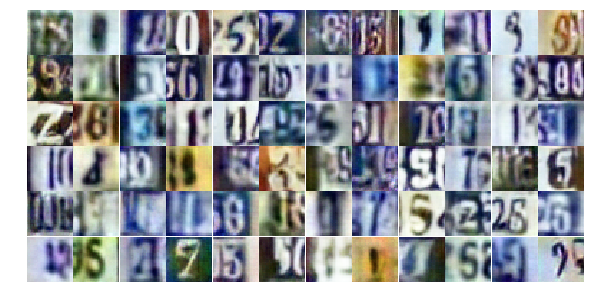

Epoch 21/30... Discriminator Loss: 1.0979... Generator Loss: 0.6119
Epoch 21/30... Discriminator Loss: 0.3929... Generator Loss: 1.6266
Epoch 21/30... Discriminator Loss: 1.4179... Generator Loss: 0.4396


KeyboardInterrupt: 

In [26]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

NameError: name 'losses' is not defined

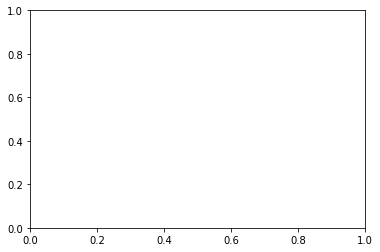

In [27]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [28]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

NameError: name 'samples' is not defined